# Incorporate Safety Specification to Learned Specification from User Demonstration on Seshia Paper's Env 

by Kandai Watanabe (kandai.watanabe@colorado.edu / kandai.wata@gmail.com)

or reach me out on github (https://github.com/watakandai)


**FOR SESHIA's paper on Learning Task Specifications from Demonstrations:**

In this notebook, we're going to incorporate safety specification to a learned specification (liveness) to safety navigate to a goal. 

We will then apply the composed specification to an environment with a different robot / environmental dynamics, but with the same intended goal as in the environment where we demonstrated the task.

This shows that we can actually learn the intended task the user had in mind when they demonstrate it on a system with actual dynamics, maitain safety, and then apply that specification to a different environment.

Change up to the main repo directory:

In [1]:
import os
os.chdir(os.path.join('..', '..'))

In [113]:
%load_ext autoreload
%autoreload 2
import gym
from IPython.display import Video, display
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from pathlib import Path
import itertools
import numpy as np
import matplotlib.pyplot as plt

plt.rcParams["font.size"] = 18
plt.rcParams["font.weight"] = 'normal'
plt.rcParams["font.family"] = 'Times New Roman'

from wombats.systems import (StaticMinigridTSWrapper,
                             LavaComparison_noDryingOff)
from wombats.automaton import active_automata
from wombats.automaton import MinigridTransitionSystem
from wombats.learning import FlexfringeInterface, TracesGenerator, DummyEstimator, BatchEstimator, ComparativeEvaluation
from wombats.learning import Vanilla, Postprocess, GreedyPreprocess, Preprocess, TargetSpecification
from wombats.learning import Dataset
from wombats.automaton import Automaton
from wombats.utils import get_experiment_paths

## Environments
# Exp2
ENV_ID_1 = 'MiniGrid-LavaComparison_seshia-v0'
ENV_ID_2 = 'MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0'
ENV_ID_3 = 'MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Wide-v0'
ENV_ID_4 = 'MiniGrid-AlternateLavaComparison_OnlyWaterPath_Wide-v0'
ENV_ID_5 = 'MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Narrow-v0'
ENV_ID_6 = 'MiniGrid-AlternateLavaComparison_OnlyWaterPath_Narrow-v0'

# setting all paths
EXPERIMENT_NAME = 'safe_pdfa_learning_performance_analysis_bounded_until'
path_data = get_experiment_paths(EXPERIMENT_NAME)
EXPERIMENT_DIR = path_data['EXPERIMENT_DIR']
PDFA_MODEL_CONFIG_FILE = path_data['PDFA_MODEL_CONFIG_FILE']
DFA_MODEL_CONFIG_FILE = path_data['DFA_MODEL_CONFIG_FILE']
LEARNER_DATA_DIR = path_data['LEARNER_DATA_DIR']
LEARNING_TRAIN_DATA_REL_FILEPATH = path_data['LEARNING_TRAIN_DATA_REL_FILEPATH']
LEARNING_TEST_DATA_REL_FILEPATH = path_data['LEARNING_TEST_DATA_REL_FILEPATH']
GYM_MONITOR_LOG_DIR = path_data['GYM_MONITOR_LOG_DIR']
ANALYSIS_DATA_DIR = path_data['ANALYSIS_DATA_DIR']
Automaton.automata_data_dir = os.path.join(EXPERIMENT_DIR)

# Constants
test_size = 0.05
num_samples = np.logspace(1, 4, num=100)
# num_samples = np.logspace(1, 3, num=5)
Ns =  [20]

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [86]:
path_data

{'EXPERIMENT_DIR': 'experiments/safe_pdfa_learning_performance_analysis_bounded_until',
 'PDFA_MODEL_CONFIG_FILE': 'wombats/config/PDFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml',
 'DFA_MODEL_CONFIG_FILE': 'wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml',
 'TS_MODEL_CONFIG_FILE': 'wombats/config/TS_safe_pdfa_learning_performance_analysis_bounded_until.yaml',
 'GYM_MONITOR_LOG_DIR': 'experiments/safe_pdfa_learning_performance_analysis_bounded_until/minigrid_env_logs',
 'LEARNER_DATA_DIR': 'experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data',
 'LEARNING_TRAIN_DATA_REL_FILEPATH': 'flexfringe_data/safe_pdfa_learning_performance_analysis_bounded_until_train',
 'LEARNING_TEST_DATA_REL_FILEPATH': 'flexfringe_data/safe_pdfa_learning_performance_analysis_bounded_until_test',
 'ANALYSIS_DATA_DIR': 'experiments/safe_pdfa_learning_performance_analysis_bounded_until/analysis'}

In [87]:
def load_automata_from_experiment(experiment_name, env_id, draw=False, just_cosafe=False):
    path_data = get_experiment_paths(experiment_name)
    pdfa_model_config_file = path_data['PDFA_MODEL_CONFIG_FILE']
    dfa_model_config_file = path_data['DFA_MODEL_CONFIG_FILE']
    
    # cosafe
    try:
        cosafe_specification = active_automata.get(automaton_type='PDFA',
                                                   graph_data=pdfa_model_config_file,
                                                   is_normalized=True)
    except Exception as e:
        cosafe_specification = None
        
    # safe
    try:
        safe_specification = active_automata.get(automaton_type='DFA',
                                                 graph_data=dfa_model_config_file)
    except Exception as e:
        safe_specification = None
    
    # pdfa
    try:
        pdfa_specification = active_automata.get(automaton_type='PDFA',
                                                 graph_data=(cosafe_specification,
                                                             safe_specification),
                                                 graph_data_format='existing_objects',
                                                 normalize_trans_probabilities=True)
    except Exception as e:
        pdfa_specification = None
    
    # env
    env = gym.make(env_id)

    env = StaticMinigridTSWrapper(env, actions_type='simple_static',
                                  monitor_log_location=GYM_MONITOR_LOG_DIR)
    env.reset()

    minigrid_TS = active_automata.get(automaton_type='TS', graph_data=env,
                                      graph_data_format='minigrid')
    
    if draw: 
        try:
            cosafe_specification.draw('_'.join([EXPERIMENT_NAME, env_id, 'PDFA']))
            safe_specification.draw('_'.join([EXPERIMENT_NAME, env_id, 'DFA']))
            pdfa_specification.draw('_'.join([EXPERIMENT_NAME, env_id, 'SPECIFICATION']))
            env.render_notebook()
        
        except Exception as e:
            print(e)
#         minigrid_TS.draw('_'.join([EXPERIMENT_NAME, env_id, 'TS']))
    
    if just_cosafe:
        return cosafe_specification, minigrid_TS
    return pdfa_specification, safe_specification, minigrid_TS

In [88]:
def solve_environment(specification, ENV_ID, actions_type='simple_static',
                      show_figures=False, record_video=True):
    
    print('using env:', ENV_ID)
    print('using actions:', actions_type)

    env = gym.make(ENV_ID)
    env = StaticMinigridTSWrapper(env, actions_type=actions_type,
                                  monitor_log_location=GYM_MONITOR_LOG_DIR)
    env.reset()
    
    TS = active_automata.get(automaton_type='TS', graph_data=env,
                             graph_data_format='minigrid')

    if show_figures:
        env.render_notebook()
        print('underlying transition system')
        TS.draw('_'.join([EXPERIMENT_NAME, ENV_ID_1, 'TS']))

    product = active_automata.get(automaton_type='Product',
                                  graph_data=(TS, specification))
    if show_figures:
        print('specification')
        specification.draw('_'.join([EXPERIMENT_NAME, ENV_ID, 'learned', 'pdfa']))
        print('product automaton')
        product.draw('_'.join([EXPERIMENT_NAME, ENV_ID, 'learned', 'product']))

    (controls,
     prob_of_controls_under_spec) = product.compute_strategy()

    print(f'Optimal Controls: {controls}')
    print(f'Probability of Generated TS Observations in Spec: ' +
          f'{prob_of_controls_under_spec}')

    (output_string,
     visited_states,
     video_path) = TS.run(controls, record_video=record_video)
    
    print(output_string)
    print(visited_states)
    if record_video:
        v = Video(video_path, embed=True,
                  html_attributes="controls muted autoplay loop")
        display(v)

In [89]:
def eval_sampled_traces(traces, record_video=False):
    if traces is None:
        return
    
    output_strings = []
    for controls, length, prob in zip(*traces):
        if controls is None:
            continue
        output_string, _, video_path = minigrid_TS.run(
            controls,
            record_video=record_video,
            overwrite_old_video=record_video)
        output_strings.append(output_string)
        
        if record_video:
            print(pdfa_specification.cross_entropy_approx(output_string))
            print(prob)
            print(length)
        
        if record_video:
            v = Video(video_path, embed=True,
                      html_attributes="controls muted autoplay loop")
            display(v)
        
    return output_strings

# Sample from the true PDFA

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:720: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)


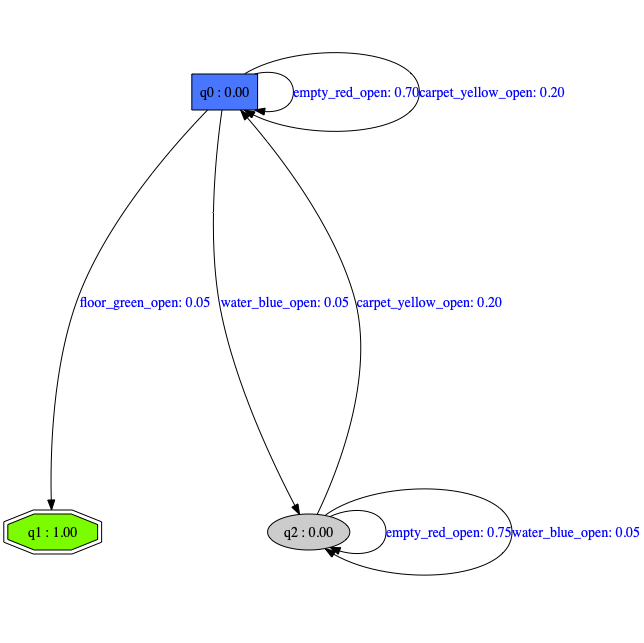

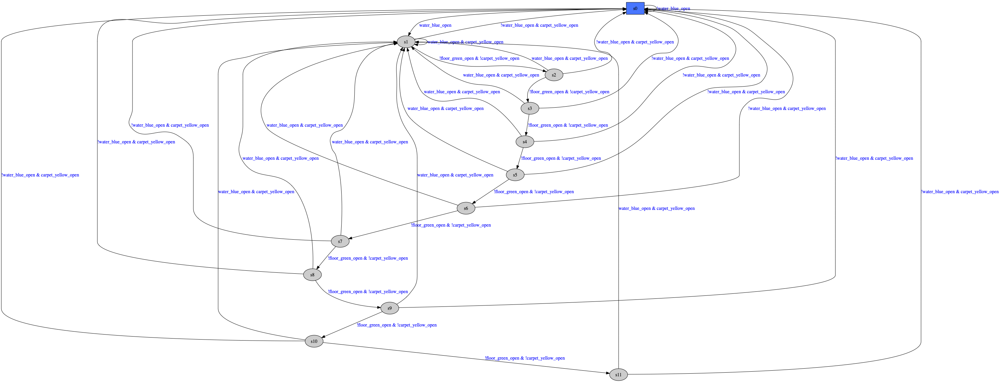

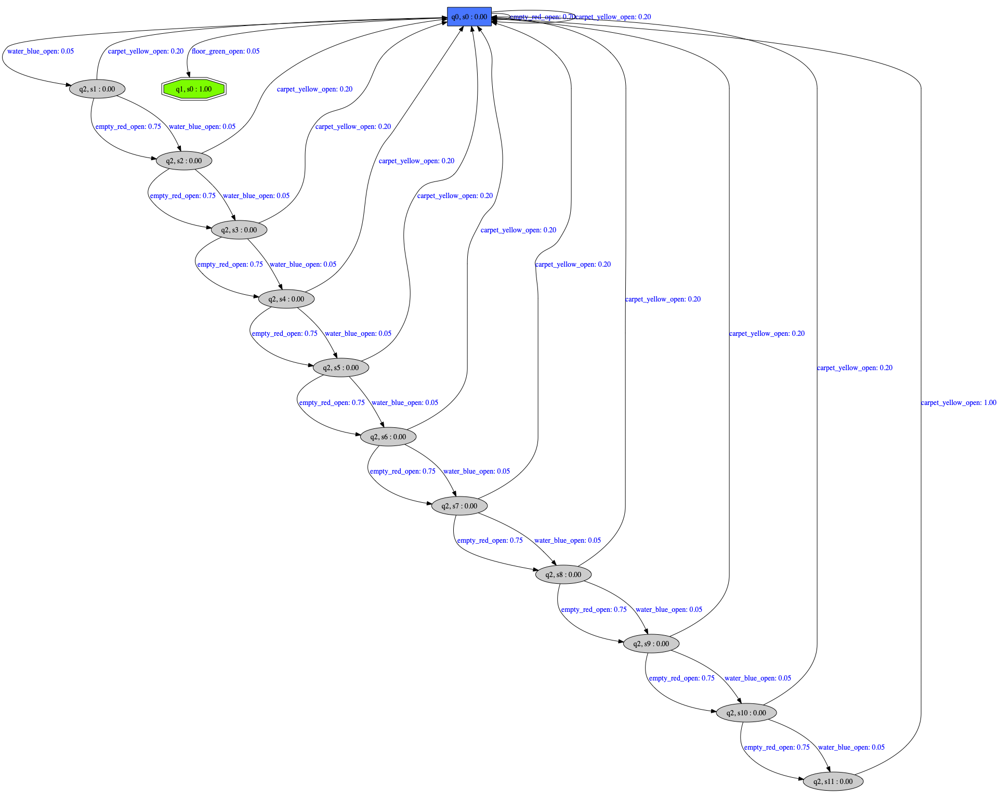

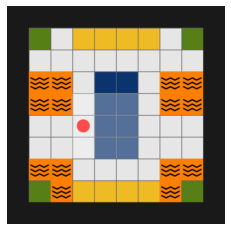

In [90]:
# env

experiment_name = 'safe_pdfa_learning_performance_analysis_bounded_until'
env_id = ENV_ID_1

pdfa_specification, safe_specification, minigrid_TS = load_automata_from_experiment(experiment_name, env_id, draw=True)

In [91]:
solve_environment(pdfa_specification, ENV_ID_1, actions_type='static')
solve_environment(pdfa_specification, ENV_ID_2, actions_type='static')
solve_environment(pdfa_specification, ENV_ID_1, actions_type='diag_static')
solve_environment(pdfa_specification, ENV_ID_2, actions_type='diag_static')

using env: MiniGrid-LavaComparison_seshia-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:720: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['left', 'forward', 'forward', 'forward', 'left', 'forward', 'forward', 'right', 'forward']
Probability of Generated TS Observations in Spec: 0.002017680349999999
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 5), up', '(3, 4), up', '(3, 3), up', '(3, 2), up', '(3, 2), left', '(2, 2), left', '(1, 2), left', '(1, 2), up', '(1, 1), up']


using env: MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:720: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['right', 'forward', 'forward', 'left', 'forward', 'forward', 'right', 'forward', 'left', 'forward', 'forward', 'forward']
Probability of Generated TS Observations in Spec: 1.6141442799999995e-05
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'carpet_yellow_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 5), down', '(3, 6), down', '(3, 7), down', '(3, 7), right', '(4, 7), right', '(5, 7), right', '(5, 7), down', '(5, 8), down', '(5, 8), right', '(6, 8), right', '(7, 8), right', '(8, 8), right']


using env: MiniGrid-LavaComparison_seshia-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:720: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['northeast', 'northwest', 'northwest', 'northeast', 'southwest', 'northwest']
Probability of Generated TS Observations in Spec: 0.00013781249999999997
['empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(4, 4), right', '(3, 3), right', '(2, 2), right', '(3, 1), right', '(2, 2), right', '(1, 1), right']


using env: MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:720: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['southwest', 'southeast', 'southeast', 'northeast', 'northeast', 'southeast', 'southeast']
Probability of Generated TS Observations in Spec: 0.0011764899999999997
['empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(2, 6), right', '(3, 7), right', '(4, 8), right', '(5, 7), right', '(6, 6), right', '(7, 7), right', '(8, 8), right']


In [92]:
# Generate Datasets
datagenerator = TracesGenerator(pdfa_specification, LEARNER_DATA_DIR)
param_dict = {'num_samples': num_samples,
              'N': Ns}
datagenerator.generate_datasets(param_dict)

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/base.py:444: UserWarning: only sampled 9996 non-zero probability strings when 10000 strings were requested. Try increasing the number of resample attempts from 10.
  warnings.warn(msg)
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/learning/dataload.py:224: UserWarning: Length of traces 9996 must belarger than num_samples 9996
  warnings.warn(msg)


In [93]:
# load data  & fit estimators
param_dict = {'num_samples':  num_samples}
datasets = datagenerator.select_datasets(param_dict)

# Create a pipeline
steps = [('clf', DummyEstimator())]
pipeline = Pipeline(steps=steps)

# Candidate learning algorithms and their hyperparameters
# param_dict = [{'clf': [Preprocess()],
param_dict = [{'clf': [Vanilla(), Postprocess(), Preprocess()],
# param_dict = [{'clf': [Vanilla(), Preprocess(), TargetSpecification()],
# param_dict = [{'clf': [Preprocess(), TargetSpecification()],
               'clf__specification': [pdfa_specification],
               'clf__safe_specification': [safe_specification],
               'clf__p': ['0.6', '5.0'],
#                'clf__p': ['0.6'],
#                'clf__p': ['5.0'],
              }]

estimator = BatchEstimator(pipeline, param_dict)
estimator.fit(datasets)

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99983 blue: 2 , red: 1
m99945 blue: 2 , red: 1
No Merge was successful
x6 blue: 1 , red: 2
No Merge was successful
x4 blue: 2 , red: 3
No Merge was successful
m99976 blue: 1 , red: 3
No Merge was successful
x4 blue: 2 , red: 4
No Merge was successful
x2 blue: 2 , red: 5
No Merge was successful
x2 blue: 2 , red: 6
No Merge was successful
x2 blue: 2 , red: 7
m99948 blue: 1 , red: 7
No M

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99974 blue: 2 , red: 1
m99961 blue: 2 , red: 1
No Merge was successful
m99788 blue: 1 , red: 1
No Merge was successful
x8 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99965 blue: 2 , red: 1
m99957 blue: 2 , red: 1
No Merge was successful
x8 blue: 1 , red: 2
No Merge was successful
x2 blue: 1 , red: 3
No Merge was successful
x2 blue: 1 , red: 4
No Merge was successful
x1 blue: 0 , red: 5


found intermediate solution with 5 and 5 red states
No valid solver specifie

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99960 blue: 2 , red: 1
m99918 blue: 2 , red: 1
m99898 blue: 1 , red: 1
No Merge was successful
x11 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec76

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99971 blue: 2 , red: 1
m99958 blue: 2 , red: 1
No Merge was successful
m99917 blue: 1 , red: 1
No Merge was successful
x12 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit 

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99974 blue: 2 , red: 1
m99960 blue: 2 , red: 1
No Merge was successful
m99904 blue: 1 , red: 1
No Merge was successful
x12 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit 

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99970 blue: 3 , red: 1
m99977 blue: 2 , red: 1
m99922 blue: 1 , red: 1
No Merge was successful
x13 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec76

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99983 blue: 2 , red: 1
m99935 blue: 2 , red: 1
No Merge was successful
m99922 blue: 1 , red: 1
No Merge was successful
x14 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit 

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s2) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99971 blue: 2 , red: 1
m99950 blue: 2 , red: 1
No Merge was successful
m99916 blue: 1 , red: 1
No Merge was successful
x15 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit 

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99978 blue: 2 , red: 1
m99954 blue: 2 , red: 1
No Merge was successful
m99880 blue: 1 , red: 1
No Merge was successful
x16 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit 

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99975 blue: 2 , red: 1
m99948 blue: 2 , red: 1
No Merge was successful
x13 blue: 1 , red: 2
No Merge was successful
x8 blue: 2 , red: 3
No Merge was successful
m99751 blue: 1 , red: 3
No Merge was successful
x6 blue: 2 , red: 4
No Merge was successful
m99902 blue: 1 , red: 4
No Merge was 

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s4) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99961 blue: 3 , red: 1
m99969 blue: 2 , red: 1
m99933 blue: 1 , red: 1
No Merge was successful
x19 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec76

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99970 blue: 2 , red: 1
m99950 blue: 2 , red: 1
No Merge was successful
x15 blue: 1 , red: 2
No Merge was successful
x10 blue: 2 , red: 3
No Merge was successful
m99525 blue: 1 , red: 3
No Merge was successful
x6 blue: 2 , red: 4
No Merge was successful
m99903 blue: 1 , red: 4
No Merge was

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99975 blue: 2 , red: 1
m99963 blue: 2 , red: 1
No Merge was successful
m99892 blue: 1 , red: 1
No Merge was successful
x23 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit 

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99975 blue: 2 , red: 1
m99962 blue: 2 , red: 1
No Merge was successful
x20 blue: 1 , red: 2
No Merge was successful
x8 blue: 2 , red: 3
m99967 blue: 1 , red: 3
No Merge was successful
x8 blue: 2 , red: 4
No Merge was successful
x4 blue: 2 , red: 5
m99960 blue: 2 , red: 5
No Merge was successful
m99952 blue: 1 , red: 5
No Merge was successful
x4 blue: 0 , red: 6


found intermediate so

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99971 blue: 2 , red: 1
m99960 blue: 2 , red: 1
No Merge was successful
x21 blue: 1 , red: 2
No Merge was successful
x10 blue: 2 , red: 3
No Merge was successful
x6 blue: 2 , red: 4
No Merge was successful
x6 blue: 3 , red: 5
No Merge was successful
x4 blue: 3 , red: 6
No Merge was successful
x4 blue:

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99977 blue: 2 , red: 1
m99955 blue: 2 , red: 1
No Merge was successful
x25 blue: 1 , red: 2
No Merge was successful
x10 blue: 2 , red: 3
No Merge was successful
x8 blue: 2 , red: 4
m99941 blue: 2 , red: 4
m99975 blue: 3 , red: 4
No Merge was successful
x2 blue: 2 , red: 5
No Merge was successful
x2 blue: 2 , red: 6
No Merge was successful
x2 blue: 1 , red: 7
No Merge was s

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99965 blue: 2 , red: 1
m99961 blue: 2 , red: 1
No Merge was successful
x25 blue: 1 , red: 2
No Merge was successful
x14 blue: 2 , red: 3
m99952 blue: 1 , red: 3
m99961 blue: 1 , red: 3
No Merge was successful
x7 blue: 0 , red: 4


found intermediate solution with 4 and 4 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution wit

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s3) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s5) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99970 blue: 3 , red: 1
m99959 blue: 2 , red: 1
m99938 blue: 1 , red: 1
No Merge was successful
x35 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec76

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99975 blue: 3 , red: 1
m99964 blue: 2 , red: 1
m99937 blue: 1 , red: 1
No Merge was successful
x37 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec76

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99973 blue: 3 , red: 1
m99963 blue: 2 , red: 1
No Merge was successful
x62 blue: 5 , red: 2
m99967 blue: 4 , red: 2
m99954 blue: 3 , red: 2
No Merge was successful
x38 blue: 5 , red: 3
m99982 blue: 4 , red: 3
m99948 blue: 4 , red: 3
No Merge was successful
x15 blue: 3 , red: 4
No Merge was successful
x12 blue: 2 , red: 5
No Merge was successful
x9 blue: 1 , red: 6
No Merge was success

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s1) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99973 blue: 3 , red: 1
m99963 blue: 2 , red: 1
No Merge was successful
x62 blue: 5 , red: 2
m99967 blue: 4 , red: 2
m99954 blue: 3 , red: 2
No Merge was successful
x38 blue: 5 , red: 3
m99982 blue: 4 , red: 3
m99948 blue: 4 , red: 3
No Merge was successful
x15 blue: 3 , red: 4
No Merge was successful
x12 blue: 2 , red: 5
No Merge was successful
x9 blue: 1 , red: 6
No Merge was success

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99968 blue: 2 , red: 1
m99958 blue: 2 , red: 1
No Merge was successful
x34 blue: 1 , red: 2
No Merge was successful
x18 blue: 2 , red: 3
No Merge was successful
x12 blue: 3 , red: 4
m99949 blue: 2 , red: 4
m99962 blue: 4 , red: 4
No Merge was successful
x6 blue: 5 , red: 5
No Merge was successful
m99967 blue: 4 , red: 5
No Merge was successful
x4 blue: 3 , red: 6
No Merge was successf

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s8) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99970 blue: 3 , red: 1
No Merge was successful
x66 blue: 6 , red: 2
No Merge was successful
m99973 blue: 5 , red: 2
No Merge was successful
m99943 blue: 4 , red: 2
No Merge was successful
x58 blue: 7 , red: 3
m99974 blue: 6 , red: 3
No Merge was successful
m99968 blue: 5 , red: 3
No Merge was successful
m99953 blue: 4 , red: 3
No Merge was successful
x50 blue: 6 , red: 4
m99942 blue: 

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99972 blue: 2 , red: 1
m99960 blue: 2 , red: 1
No Merge was successful
x39 blue: 1 , red: 2
No Merge was successful
x20 blue: 2 , red: 3
m99957 blue: 2 , red: 3
m99954 blue: 1 , red: 3
No Merge was successful
x20 blue: 2 , red: 4
m99961 blue: 3 , red: 4
m99968 blue: 2 , red: 4
No Merge was successful
x8 blue: 3 , red: 5
No Merge was successful
m99967 blue: 3 , red: 5
No Merge was succ

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99966 blue: 2 , red: 1
m99956 blue: 2 , red: 1
No Merge was successful
x41 blue: 1 , red: 2
No Merge was successful
x22 blue: 2 , red: 3
m99964 blue: 2 , red: 3
m99958 blue: 1 , red: 3
No Merge was successful
x22 blue: 2 , red: 4
m99964 blue: 3 , red: 4
m99963 blue: 2 , red: 4
No Merge was successful
x10 blue: 3 , red: 5
m99969 blue: 3 , red: 5
No Merge was successful
x6 blue: 2 , red

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99967 blue: 2 , red: 1
m99958 blue: 2 , red: 1
No Merge was successful
m99929 blue: 1 , red: 1
No Merge was successful
x56 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit 

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99970 blue: 3 , red: 1
m99947 blue: 2 , red: 1
No Merge was successful
x47 blue: 1 , red: 2
No Merge was successful
x26 blue: 2 , red: 3
No Merge was successful
m99942 blue: 1 , red: 3
No Merge was successful
x18 blue: 3 , red: 4
m99974 blue: 2 , red: 4
No Merge was successful
x16 blue: 4 , red: 5
m9

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q2, s11) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99973 blue: 3 , red: 1
m99967 blue: 2 , red: 1
m99948 blue: 1 , red: 1
No Merge was successful
x65 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec76

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s10) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 3 , red: 1
m99961 blue: 3 , red: 1
m99954 blue: 2 , red: 1
m99929 blue: 1 , red: 1
No Merge was successful
x69 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec76

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99965 blue: 3 , red: 1
m99958 blue: 2 , red: 1
No Merge was successful
x58 blue: 1 , red: 2
No Merge was successful
x34 blue: 2 , red: 3
No Merge was successful
m99942 blue: 1 , red: 3
No Merge was successful
x26 blue: 3 , red: 4
m99972 blue: 2 , red: 4
No Merge was successful
x20 blue: 4 , red: 5
m9

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99963 blue: 3 , red: 1
m99947 blue: 2 , red: 1
No Merge was successful
x64 blue: 1 , red: 2
No Merge was successful
x32 blue: 2 , red: 3
No Merge was successful
m99942 blue: 1 , red: 3
No Merge was successful
x24 blue: 3 , red: 4
m99974 blue: 2 , red: 4
No Merge was successful
m99880 blue

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99966 blue: 3 , red: 1
m99945 blue: 2 , red: 1
No Merge was successful
x75 blue: 1 , red: 2
No Merge was successful
x34 blue: 2 , red: 3
m99956 blue: 2 , red: 3
No Merge was successful
x32 blue: 3 , red: 4
m99953 blue: 4 , red: 4
No Merge was successful
m99957 blue: 3 , red: 4
No Merge was successful
m99952 blue: 2 , red: 4
No Merge was successful
x13 blue: 1 , red: 5
No M

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99965 blue: 3 , red: 1
m99945 blue: 2 , red: 1
No Merge was successful
x79 blue: 1 , red: 2
No Merge was successful
x40 blue: 2 , red: 3
m99961 blue: 2 , red: 3
m99948 blue: 1 , red: 3
No Merge was successful
x40 blue: 3 , red: 4
m99972 blue: 2 , red: 4
No Merge was successful
x32 blue: 4 , red: 5
No Merge was successful
x26 blue: 7 , red: 6
m99962 blue: 6 , red: 6
No Merge was succes

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99965 blue: 3 , red: 1
m99945 blue: 2 , red: 1
No Merge was successful
x79 blue: 1 , red: 2
No Merge was successful
x40 blue: 2 , red: 3
No Merge was successful
m99944 blue: 1 , red: 3
No Merge was successful
x34 blue: 3 , red: 4
m99967 blue: 2 , red: 4
No Merge was successful
m99874 blue

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99966 blue: 3 , red: 1
m99946 blue: 2 , red: 1
No Merge was successful
x89 blue: 1 , red: 2
No Merge was successful
x48 blue: 2 , red: 3
m99966 blue: 2 , red: 3
No Merge was successful
x42 blue: 4 , red: 4
m99964 blue: 4 , red: 4
No Merge was successful
m99966 blue: 3 , red: 4
No Merge was successful
x15 blue: 2 , red: 5
No Merge was successful
x12 blue: 3 , red: 6
m99965 

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s7) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99966 blue: 3 , red: 1
m99946 blue: 2 , red: 1
No Merge was successful
m99921 blue: 1 , red: 1
No Merge was successful
x113 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s6) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99973 blue: 3 , red: 1
m99963 blue: 2 , red: 1
m99946 blue: 1 , red: 1
No Merge was successful
x121 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec7

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99970 blue: 3 , red: 1
m99960 blue: 2 , red: 1
m99946 blue: 1 , red: 1
No Merge was successful
x130 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec7

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99964 blue: 3 , red: 1
m99955 blue: 2 , red: 1
No Merge was successful
m99907 blue: 1 , red: 1
No Merge was successful
x140 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99964 blue: 3 , red: 1
m99955 blue: 2 , red: 1
No Merge was successful
x109 blue: 1 , red: 2
No Merge was successful
x62 blue: 2 , red: 3
No Merge was successful
m99901 blue: 1 , red: 3
No Merge was successful
x54 blue: 3 , red: 4
m99970 blue: 2 , red: 4
No Merge was successful
m99890 blu

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99964 blue: 3 , red: 1
m99948 blue: 2 , red: 1
No Merge was successful
x119 blue: 1 , red: 2
No Merge was successful
x62 blue: 2 , red: 3
No Merge was successful
m99925 blue: 1 , red: 3
No Merge was successful
x50 blue: 3 , red: 4
m99973 blue: 2 , red: 4
No Merge was successful
m99866 blu

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99961 blue: 3 , red: 1
m99954 blue: 2 , red: 1
No Merge was successful
x121 blue: 1 , red: 2
No Merge was successful
x78 blue: 3 , red: 3
No Merge was successful
x58 blue: 5 , red: 4
m99970 blue: 4 , red: 4
No Merge was successful
x46 blue: 6 , red: 5
No Merge was successful
m99974 blue: 5 , red: 5
N

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99962 blue: 3 , red: 1
m99953 blue: 2 , red: 1
No Merge was successful
m99896 blue: 1 , red: 1
No Merge was successful
x172 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99962 blue: 3 , red: 1
m99953 blue: 2 , red: 1
No Merge was successful
x134 blue: 1 , red: 2
No Merge was successful
x76 blue: 2 , red: 3
No Merge was successful
m99896 blue: 1 , red: 3
No Merge was successful
x58 blue: 3 , red: 4
m99956 blue: 2 , red: 4
No Merge was successful
m99872 blu

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99962 blue: 3 , red: 1
m99951 blue: 2 , red: 1
No Merge was successful
x145 blue: 1 , red: 2
No Merge was successful
x80 blue: 3 , red: 3
No Merge was successful
x64 blue: 5 , red: 4
m99970 blue: 4 , red: 4
No Merge was successful
x52 blue: 6 , red: 5
m99971 blue: 5 , red: 5
m99965 blue: 4 , red: 5
m

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99968 blue: 3 , red: 1
m99956 blue: 2 , red: 1
No Merge was successful
x154 blue: 1 , red: 2
No Merge was successful
x88 blue: 3 , red: 3
No Merge was successful
m99963 blue: 2 , red: 3
No Merge was successful
x64 blue: 4 , red: 4
m99946 blue: 3 , red: 4
m99941 blue: 2 , red: 4
m99949 blue: 1 , red: 4
No Merge was successful
x88 blue: 4 , red: 5
m99959 blue: 3 , red: 5
m99960 blue: 2 

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99952 blue: 2 , red: 1
No Merge was successful
x162 blue: 1 , red: 2
No Merge was successful
x100 blue: 3 , red: 3
m99976 blue: 2 , red: 3
m99952 blue: 1 , red: 3
No Merge was successful
x100 blue: 4 , red: 4
m99945 blue: 3 , red: 4
No Merge was successful
x78 blue: 5 , red: 5
m99966 blue: 4 , red: 5
m99947 blue: 3 , red: 5
No Merge was successful
x29 blue: 2 ,

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99952 blue: 2 , red: 1
No Merge was successful
x162 blue: 1 , red: 2
No Merge was successful
x100 blue: 3 , red: 3
m99947 blue: 2 , red: 3
No Merge was successful
m99918 blue: 1 , red: 3
No Merge was successful
x80 blue: 3 , red: 4
m99922 blue: 2 , red: 4
No Merge 

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99956 blue: 3 , red: 1
m99944 blue: 2 , red: 1
No Merge was successful
x180 blue: 1 , red: 2
No Merge was successful
x96 blue: 3 , red: 3
m99948 blue: 2 , red: 3
No Merge was successful
m99924 blue: 1 , red: 3
No Merge was successful
x78 blue: 3 , red: 4
m99929 blue: 2 , red: 4
No Merge w

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99963 blue: 3 , red: 1
m99951 blue: 2 , red: 1
No Merge was successful
x193 blue: 1 , red: 2
No Merge was successful
x102 blue: 3 , red: 3
m99948 blue: 2 , red: 3
No Merge was successful
m99923 blue: 1 , red: 3
No Merge was successful
x80 blue: 3 , red: 4
m99950 blue: 2 , red: 4
No Merge 

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99964 blue: 3 , red: 1
m99952 blue: 2 , red: 1
No Merge was successful
x206 blue: 1 , red: 2
No Merge was successful
x112 blue: 3 , red: 3
m99944 blue: 2 , red: 3
No Merge was successful
x84 blue: 4 , red: 4
m99947 blue: 3 , red: 4
No Merge was successful
x68 blue: 5 , red: 5
m99950 blue: 4 , red: 5


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99965 blue: 3 , red: 1
m99950 blue: 2 , red: 1
No Merge was successful
x221 blue: 1 , red: 2
No Merge was successful
x120 blue: 3 , red: 3
m99975 blue: 2 , red: 3
m99952 blue: 1 , red: 3
No Merge was successful
x120 blue: 4 , red: 4
m99955 blue: 3 , red: 4
No Merge was successful
x92 blue: 6 , red: 5
m99964 blue: 5 , red: 5
m99941 blue: 4 , red: 5
No Merge was successful
x31 blue: 3 ,

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99953 blue: 2 , red: 1
No Merge was successful
x243 blue: 1 , red: 2
No Merge was successful
x116 blue: 3 , red: 3
m99961 blue: 2 , red: 3
m99948 blue: 1 , red: 3
No Merge was successful
x116 blue: 4 , red: 4
m99975 blue: 3 , red: 4
No Merge was successful
x88 blue: 6 , red: 5
m99974 blue: 5 , red: 5
m99948 blue: 4 , red: 5
No Merge was successful
m99948 blue: 

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99953 blue: 2 , red: 1
No Merge was successful
x243 blue: 1 , red: 2
No Merge was successful
x116 blue: 3 , red: 3
m99961 blue: 2 , red: 3
No Merge was successful
m99924 blue: 1 , red: 3
No Merge was successful
x94 blue: 3 , red: 4
m99945 blue: 2 , red: 4
No Merge 

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
m99956 blue: 2 , red: 1
No Merge was successful
m99902 blue: 1 , red: 1
No Merge was successful
x323 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99958 blue: 3 , red: 1
m99945 blue: 2 , red: 1
m99933 blue: 1 , red: 1
No Merge was successful
x346 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec7

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99957 blue: 3 , red: 1
m99950 blue: 2 , red: 1
No Merge was successful
x500 blue: 5 , red: 2
m99954 blue: 4 , red: 2
m99960 blue: 3 , red: 2
No Merge was successful
x330 blue: 6 , red: 3
m99953 blue: 5 , red: 3
m99949 blue: 4 , red: 3
No Merge was successful
x302 blue: 7 , red: 4
m99945 blue: 6 , red: 4
m99943 blue: 5 , red: 4
No Merge was successful
x282 blue: 8 , red: 5
m99950 blue:

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s9) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99957 blue: 3 , red: 1
m99950 blue: 2 , red: 1
No Merge was successful
x500 blue: 5 , red: 2
m99954 blue: 4 , red: 2
m99960 blue: 3 , red: 2
No Merge was successful
x330 blue: 6 , red: 3
m99953 blue: 5 , red: 3
m99949 blue: 4 , red: 3
No Merge was successful
x302 blue: 7 , red: 4
m99945 blue: 6 , red: 4
m99943 blue: 5 , red: 4
No Merge was successful
x282 blue: 8 , red: 5
m99950 blue:

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99957 blue: 3 , red: 1
m99937 blue: 2 , red: 1
No Merge was successful
x299 blue: 1 , red: 2
No Merge was successful
x146 blue: 3 , red: 3
m99962 blue: 2 , red: 3
No Merge was successful
m99914 blue: 1 , red: 3
No Merge was successful
x118 blue: 3 , red: 4
m99943 blue: 2 , red: 4
No Merge

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99961 blue: 3 , red: 1
m99941 blue: 2 , red: 1
No Merge was successful
x306 blue: 1 , red: 2
No Merge was successful
x184 blue: 3 , red: 3
m99971 blue: 2 , red: 3
No Merge was successful
m99909 blue: 1 , red: 3
No Merge was successful
x148 blue: 3 , red: 4
m99934 blue: 2 , red: 4
No Merge

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99949 blue: 2 , red: 1
m99932 blue: 1 , red: 1
No Merge was successful
x427 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec7

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
m99958 blue: 2 , red: 1
No Merge was successful
x658 blue: 5 , red: 2
m99967 blue: 4 , red: 2
m99953 blue: 3 , red: 2
m99946 blue: 2 , red: 2
No Merge was successful
x329 blue: 1 , red: 3
No Merge was successful
x129 blue: 0 , red: 4


found intermediate solution with 4 and 4 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


fou

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q2, s11) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
m99958 blue: 2 , red: 1
No Merge was successful
x658 blue: 5 , red: 2
m99967 blue: 4 , red: 2
m99953 blue: 3 , red: 2
m99946 blue: 2 , red: 2
No Merge was successful
x329 blue: 1 , red: 3
No Merge was successful
x129 blue: 0 , red: 4


found intermediate solution with 4 and 4 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


fou

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
m99961 blue: 2 , red: 1
No Merge was successful
x696 blue: 5 , red: 2
m99960 blue: 4 , red: 2
m99955 blue: 3 , red: 2
m99943 blue: 2 , red: 2
No Merge was successful
x348 blue: 1 , red: 3
No Merge was successful
x143 blue: 0 , red: 4


found intermediate solution with 4 and 4 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , 

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
m99945 blue: 2 , red: 1
No Merge was successful
x382 blue: 1 , red: 2
No Merge was successful
x218 blue: 3 , red: 3
m99966 blue: 2 , red: 3
No Merge was successful
m99904 blue: 1 , red: 3
No Merge was successful
x178 blue: 3 , red: 4
m99963 blue: 2 , red: 4
No Merge

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99958 blue: 3 , red: 1
m99943 blue: 2 , red: 1
No Merge was successful
x420 blue: 1 , red: 2
No Merge was successful
x212 blue: 3 , red: 3
m99969 blue: 2 , red: 3
No Merge was successful
m99908 blue: 1 , red: 3
No Merge was successful
x166 blue: 3 , red: 4
m99956 blue: 2 , red: 4
No Merge

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
m99943 blue: 2 , red: 1
No Merge was successful
x445 blue: 1 , red: 2
No Merge was successful
x238 blue: 3 , red: 3
m99965 blue: 2 , red: 3
No Merge was successful
m99909 blue: 1 , red: 3
No Merge was successful
x186 blue: 3 , red: 4
m99959 blue: 2 , red: 4
No Merge

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99961 blue: 3 , red: 1
m99950 blue: 2 , red: 1
No Merge was successful
x484 blue: 1 , red: 2
No Merge was successful
x242 blue: 3 , red: 3
m99959 blue: 2 , red: 3
No Merge was successful
m99916 blue: 1 , red: 3
No Merge was successful
x200 blue: 3 , red: 4
m99961 blue: 2 , red: 4
No Merge

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99953 blue: 3 , red: 1
m99950 blue: 2 , red: 1
No Merge was successful
x514 blue: 1 , red: 2
No Merge was successful
x270 blue: 3 , red: 3
m99960 blue: 2 , red: 3
No Merge was successful
m99911 blue: 1 , red: 3
No Merge was successful
x224 blue: 3 , red: 4
m99938 blue: 2 , red: 4
No Merge

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99958 blue: 3 , red: 1
m99943 blue: 2 , red: 1
No Merge was successful
x559 blue: 1 , red: 2
No Merge was successful
x274 blue: 3 , red: 3
m99958 blue: 2 , red: 3
No Merge was successful
m99910 blue: 1 , red: 3
No Merge was successful
x220 blue: 3 , red: 4
m99972 blue: 2 , red: 4
No Merge

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
m99942 blue: 2 , red: 1
No Merge was successful
x594 blue: 1 , red: 2
No Merge was successful
x304 blue: 3 , red: 3
m99956 blue: 2 , red: 3
No Merge was successful
m99912 blue: 1 , red: 3
No Merge was successful
x250 blue: 3 , red: 4
m99966 blue: 2 , red: 4
No Merge

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99954 blue: 2 , red: 1
No Merge was successful
m99910 blue: 1 , red: 1
No Merge was successful
x800 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99961 blue: 3 , red: 1
m99948 blue: 2 , red: 1
No Merge was successful
x1198 blue: 5 , red: 2
m99956 blue: 4 , red: 2
No Merge was successful
x694 blue: 7 , red: 3
m99952 blue: 6 , red: 3
m99947 blue: 5 , red: 3
m99942 blue: 4 , red: 3
No Merge was successful
x600 blue: 7 , red: 4
m99962 blue: 6 , red: 4
m99960 blue: 5 , red: 4
No Merge was successful
x558 blue: 8 , red: 5
m99953 blue

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99961 blue: 3 , red: 1
m99948 blue: 2 , red: 1
m99935 blue: 1 , red: 1
No Merge was successful
x858 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec7

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99954 blue: 2 , red: 1
No Merge was successful
x1314 blue: 5 , red: 2
m99956 blue: 4 , red: 2
m99949 blue: 3 , red: 2
No Merge was successful
x517 blue: 2 , red: 3
No Merge was successful
x280 blue: 4 , red: 4
No Merge was successful
m99962 blue: 3 , red: 4
No Merge was successful
m99941 blue: 2 , red: 4
No Merge was successful
x280 blue: 5 , red: 5
No Merge wa

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99940 blue: 2 , red: 1
No Merge was successful
x716 blue: 1 , red: 2
No Merge was successful
x408 blue: 3 , red: 3
m99958 blue: 2 , red: 3
No Merge was successful
m99918 blue: 1 , red: 3
No Merge was successful
x332 blue: 3 , red: 4
m99965 blue: 2 , red: 4
No Merge

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99963 blue: 3 , red: 1
m99943 blue: 2 , red: 1
No Merge was successful
x778 blue: 1 , red: 2
No Merge was successful
x416 blue: 3 , red: 3
m99959 blue: 2 , red: 3
No Merge was successful
m99918 blue: 1 , red: 3
No Merge was successful
x326 blue: 3 , red: 4
m99949 blue: 2 , red: 4
No Merge

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99963 blue: 3 , red: 1
m99953 blue: 2 , red: 1
m99935 blue: 1 , red: 1
No Merge was successful
x1057 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99962 blue: 3 , red: 1
m99948 blue: 2 , red: 1
No Merge was successful
x1608 blue: 5 , red: 2
m99954 blue: 4 , red: 2
m99949 blue: 3 , red: 2
No Merge was successful
x636 blue: 2 , red: 3
No Merge was successful
x336 blue: 4 , red: 4
No Merge was successful
m99954 blue: 3 , red: 4
No Merge was successful
x330 blue: 2 , red: 5
No Merge was successful
x250 blue: 4 , red: 6
m99974 blue: 

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99962 blue: 3 , red: 1
m99948 blue: 2 , red: 1
m99935 blue: 1 , red: 1
No Merge was successful
x1134 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99962 blue: 3 , red: 1
m99952 blue: 2 , red: 1
No Merge was successful
x956 blue: 1 , red: 2
No Merge was successful
x520 blue: 3 , red: 3
m99958 blue: 2 , red: 3
m99948 blue: 1 , red: 3
No Merge was successful
x520 blue: 4 , red: 4
m99952 blue: 3 , red: 4
m99941 blue: 2 , red: 4
No Merge was successful
x452 blue: 5 , red: 5
m99949 blue: 4 , red: 5
m99946 blue: 3 , red: 5
No Merge was

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99962 blue: 3 , red: 1
m99952 blue: 2 , red: 1
No Merge was successful
x956 blue: 1 , red: 2
No Merge was successful
x520 blue: 3 , red: 3
m99958 blue: 2 , red: 3
No Merge was successful
m99925 blue: 1 , red: 3
No Merge was successful
x422 blue: 3 , red: 4
m99967 blue: 2 , red: 4
No Merge

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99961 blue: 3 , red: 1
m99953 blue: 2 , red: 1
No Merge was successful
x1034 blue: 1 , red: 2
No Merge was successful
x540 blue: 3 , red: 3
m99957 blue: 2 , red: 3
No Merge was successful
x428 blue: 4 , red: 4
m99959 blue: 3 , red: 4
No Merge was successful
m99955 blue: 2 , red: 4
No Merge was succes

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99951 blue: 2 , red: 1
m99935 blue: 1 , red: 1
No Merge was successful
x1398 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99952 blue: 2 , red: 1
No Merge was successful
x2144 blue: 5 , red: 2
m99958 blue: 4 , red: 2
m99951 blue: 3 , red: 2
No Merge was successful
x863 blue: 2 , red: 3
No Merge was successful
x427 blue: 1 , red: 4
No Merge was successful
x418 blue: 3 , red: 5
m99950 blue: 2 , red: 5
No Merge was successful
x310 blue: 4 , red: 6
m99960 blue: 3 , red: 6
m99944 blue: 

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99941 blue: 2 , red: 1
No Merge was successful
x1179 blue: 1 , red: 2
No Merge was successful
x640 blue: 3 , red: 3
m99956 blue: 2 , red: 3
No Merge was successful
m99918 blue: 1 , red: 3
No Merge was successful
x512 blue: 3 , red: 4
m99966 blue: 2 , red: 4
No Merg

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99953 blue: 2 , red: 1
No Merge was successful
x2272 blue: 5 , red: 2
m99956 blue: 4 , red: 2
No Merge was successful
x1360 blue: 7 , red: 3
m99953 blue: 6 , red: 3
m99950 blue: 5 , red: 3
No Merge was successful
x730 blue: 8 , red: 4
m99956 blue: 7 , red: 4
m99950 blue: 6 , red: 4
No Merge was successful
x624 blue: 9 , red: 5
No Merge was successful
m99955 blu

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99941 blue: 2 , red: 1
No Merge was successful
x1273 blue: 1 , red: 2
No Merge was successful
x670 blue: 3 , red: 3
m99962 blue: 2 , red: 3
No Merge was successful
m99920 blue: 1 , red: 3
No Merge was successful
x532 blue: 3 , red: 4
m99955 blue: 2 , red: 4
No Merg

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99951 blue: 2 , red: 1
m99934 blue: 1 , red: 1
No Merge was successful
x1724 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

welcome, running git commit c8fad5bd3b0c0dad0e28ec

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99940 blue: 2 , red: 1
No Merge was successful
x1361 blue: 1 , red: 2
No Merge was successful
x726 blue: 3 , red: 3
m99957 blue: 2 , red: 3
No Merge was successful
m99921 blue: 1 , red: 3
No Merge was successful
x580 blue: 3 , red: 4
m99961 blue: 2 , red: 4
No Merg

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99961 blue: 3 , red: 1
m99941 blue: 2 , red: 1
No Merge was successful
x1462 blue: 1 , red: 2
No Merge was successful
x772 blue: 3 , red: 3
m99958 blue: 2 , red: 3
No Merge was successful
x590 blue: 4 , red: 4
m99961 blue: 3 , red: 4
No Merge was successful
m99950 blue: 2 , red: 4
No Merge was succes

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99945 blue: 2 , red: 1
No Merge was successful
x2810 blue: 5 , red: 2
m99956 blue: 4 , red: 2
m99949 blue: 3 , red: 2
No Merge was successful
x1136 blue: 2 , red: 3
No Merge was successful
x577 blue: 1 , red: 4
No Merge was successful
x538 blue: 3 , red: 5
m99962 blue: 2 , red: 5
m99946 blue: 1 , red: 5
No Merge was successful
x538 blue: 4 , red: 6
m99965 blue:

loaded fdfa
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99938 blue: 2 , red: 1
No Merge was successful
x1577 blue: 1 , red: 2
No Merge was successful
x810 blue: 3 , red: 3
m99955 blue: 2 , red: 3
No Merge was successful
m99921 blue: 1 , red: 3
No Merge was successful
x652 blue: 3 , red: 4
m99963 blue: 2 , red: 4
No Merg

[Parallel(n_jobs=4)]: Done 532 out of 532 | elapsed:    4.5s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99958 blue: 3 , red: 1
m99946 blue: 2 , red: 1
m99936 blue: 1 , red: 1
No Merge was successful
x2125 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver spec

[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1982s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 128 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 144 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.9s
[P

[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 296 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 328 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 360 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1727s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  20 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  22 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  24 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    0.4s
[Pa

[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0775s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.6s
[P

[Parallel(n_jobs=4)]: Done 481 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 482 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 514 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 515 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 516 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 517 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 518 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 519 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 520 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 521 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 522 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 523 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 524 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 525 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 526 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 527 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 501 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 502 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 503 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 505 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 506 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 507 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 508 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 541 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 543 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 545 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 547 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  22 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  26 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0587s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.3s
[Pa

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0637s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1589s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.3s
[Parallel(n_jobs=

[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1810s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 409 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 410 tasks      | elapsed:    1.1s
[P

[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1496s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    0.8s
[P

[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 410 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 412 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 414 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 416 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 418 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 420 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 422 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 454 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 456 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 458 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 460 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 492 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 304 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 320 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 336 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 352 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 368 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 384 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 400 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 416 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 432 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 448 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 464 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 480 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 496 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 512 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 528 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 594 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 596 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 598 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 604 out of 611 | elapsed:    1.7s remaining:    0.0s
[Parallel(n_jobs=4)]: Done 611 out of 611 | elapsed:    1.7s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
d

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0669s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 266 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    6.9s
[Parallel(n_jobs=4)]: Done 294 tasks      | elapsed:    6.9s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 538 tasks      | elapsed:   12.2s
[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:   12.2s
[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:   12.3s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:   12.3s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:   12.3s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:   12.4s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:   12.4s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:   12.5s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:   12.5s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:   12.5s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   12.6s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:   12.6s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:   12.6s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:   12.7s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:   12.7s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:   12.8s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 522 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 524 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 526 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 528 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 530 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 532 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 534 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 538 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Do

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99961 blue: 3 , red: 1
m99950 blue: 2 , red: 1
m99934 blue: 1 , red: 1
No Merge was successful
x2620 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

[Parallel(n_jobs=4)]: Using backend LokyBackend wi

[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0932s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1769s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 216 tasks     

[Parallel(n_jobs=4)]: Done 647 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 648 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 655 out of 655 | elapsed:    1.7s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99961 blue: 3 , red: 1
m99941 blue: 2 , red: 1
No Merge was successful
x2086 blue: 1 , red: 2
No Merge was su

[Parallel(n_jobs=4)]: Done  24 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  26 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  30 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done  34 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done  38 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done  46 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done  50 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done  54 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 500 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 508 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 512 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 516 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 520 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 524 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 528 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 532 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 569 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 601 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 602 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 603 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 604 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 605 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 606 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 607 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 639 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 640 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 647 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 648 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 649 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 650 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 651 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 652 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 653 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 654 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 655 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 656 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 657 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 658 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 659 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 660 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 661 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 662 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 668 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 669 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 670 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 671 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 672 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 673 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 674 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 675 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 676 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 677 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 678 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 679 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 680 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 681 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 682 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 683 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 132 tasks      | elapsed:    3.0s
[Parallel(n_jobs=4)]: Done 134 tasks      | elapsed:    3.1s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    3.1s
[Parallel(n_jobs=4)]: Done 138 tasks      | elapsed:    3.2s
[Parallel(n_jobs=4)]: Done 140 tasks      | elapsed:    3.2s
[Parallel(n_jobs=4)]: Done 142 tasks      | elapsed:    3.3s
[Parallel(n_jobs=4)]: Done 144 tasks      | elapsed:    3.3s
[Parallel(n_jobs=4)]: Done 146 tasks      | elapsed:    3.3s
[Parallel(n_jobs=4)]: Done 148 tasks      | elapsed:    3.4s
[Parallel(n_jobs=4)]: Done 150 tasks      | elapsed:    3.4s
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    3.5s
[Parallel(n_jobs=4)]: Done 154 tasks      | elapsed:    3.5s
[Parallel(n_jobs=4)]: Done 156 tasks      | elapsed:    3.5s
[Parallel(n_jobs=4)]: Done 158 tasks      | elapsed:    3.6s
[Parallel(n_jobs=4)]: Done 160 tasks      | elapsed:    3.6s
[Parallel(n_jobs=4)]: Done 162 tasks      | elapsed:    3.7s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 404 tasks      | elapsed:    8.8s
[Parallel(n_jobs=4)]: Done 406 tasks      | elapsed:    8.8s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    8.8s
[Parallel(n_jobs=4)]: Done 410 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 412 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 414 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 416 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 418 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 420 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 422 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 424 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 426 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 428 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 430 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 432 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 434 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 676 tasks      | elapsed:   14.5s
[Parallel(n_jobs=4)]: Done 678 tasks      | elapsed:   14.5s
[Parallel(n_jobs=4)]: Done 680 tasks      | elapsed:   14.5s
[Parallel(n_jobs=4)]: Done 682 tasks      | elapsed:   14.6s
[Parallel(n_jobs=4)]: Done 684 tasks      | elapsed:   14.6s
[Parallel(n_jobs=4)]: Done 686 tasks      | elapsed:   14.7s
[Parallel(n_jobs=4)]: Done 688 tasks      | elapsed:   14.7s
[Parallel(n_jobs=4)]: Done 690 tasks      | elapsed:   14.7s
[Parallel(n_jobs=4)]: Done 692 tasks      | elapsed:   14.8s
[Parallel(n_jobs=4)]: Done 694 tasks      | elapsed:   14.8s
[Parallel(n_jobs=4)]: Done 696 tasks      | elapsed:   14.9s
[Parallel(n_jobs=4)]: Done 703 out of 703 | elapsed:   15.2s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_u

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0920s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 492 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 496 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 500 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done 508 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done 512 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done 516 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done 520 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 524 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 528 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 532 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 569 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 570 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 571 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 572 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 573 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 574 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1909s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    1.0s
[P

[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 600 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 635 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 638 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 641 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 644 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 647 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 650 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 653 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 656 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 659 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 662 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 665 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 668 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 100 tasks      | elapsed:    2.3s
[Parallel(n_jobs=4)]: Done 102 tasks      | elapsed:    2.4s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    2.4s
[Parallel(n_jobs=4)]: Done 106 tasks      | elapsed:    2.5s
[Parallel(n_jobs=4)]: Done 108 tasks      | elapsed:    2.5s
[Parallel(n_jobs=4)]: Done 110 tasks      | elapsed:    2.6s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    2.6s
[Parallel(n_jobs=4)]: Done 114 tasks      | elapsed:    2.6s
[Parallel(n_jobs=4)]: Done 116 tasks      | elapsed:    2.7s
[Parallel(n_jobs=4)]: Done 118 tasks      | elapsed:    2.7s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    2.8s
[Parallel(n_jobs=4)]: Done 122 tasks      | elapsed:    2.8s
[Parallel(n_jobs=4)]: Done 124 tasks      | elapsed:    2.9s
[Parallel(n_jobs=4)]: Done 126 tasks      | elapsed:    2.9s
[Parallel(n_jobs=4)]: Done 128 tasks      | elapsed:    2.9s
[Parallel(n_jobs=4)]: Done 130 tasks      | elapsed:    3.0s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 370 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 372 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 374 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 378 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 380 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 382 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 384 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 386 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 388 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 390 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 392 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Done 394 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Done 396 tasks      | elapsed:    9.5s
[Parallel(n_jobs=4)]: Done 398 tasks      | elapsed:    9.5s
[Parallel(n_jobs=4)]: Done 400 tasks      | elapsed:    9.6s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 646 tasks      | elapsed:   15.7s
[Parallel(n_jobs=4)]: Done 648 tasks      | elapsed:   15.7s
[Parallel(n_jobs=4)]: Done 650 tasks      | elapsed:   15.8s
[Parallel(n_jobs=4)]: Done 652 tasks      | elapsed:   15.8s
[Parallel(n_jobs=4)]: Done 654 tasks      | elapsed:   15.8s
[Parallel(n_jobs=4)]: Done 656 tasks      | elapsed:   15.9s
[Parallel(n_jobs=4)]: Done 658 tasks      | elapsed:   15.9s
[Parallel(n_jobs=4)]: Done 660 tasks      | elapsed:   16.0s
[Parallel(n_jobs=4)]: Done 662 tasks      | elapsed:   16.0s
[Parallel(n_jobs=4)]: Done 664 tasks      | elapsed:   16.0s
[Parallel(n_jobs=4)]: Done 666 tasks      | elapsed:   16.1s
[Parallel(n_jobs=4)]: Done 668 tasks      | elapsed:   16.1s
[Parallel(n_jobs=4)]: Done 670 tasks      | elapsed:   16.2s
[Parallel(n_jobs=4)]: Done 672 tasks      | elapsed:   16.2s
[Parallel(n_jobs=4)]: Done 674 tasks      | elapsed:   16.2s
[Parallel(n_jobs=4)]: Done 676 tasks      | elapsed:   16.3s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 682 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 683 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 684 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 685 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 701 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 702 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 703 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 704 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 705 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 706 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 707 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 708 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 709 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 710 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 711 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 712 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Do

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0648s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 266 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 294 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 538 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0656s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0823s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      |

[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0526s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1202s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  1

[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0673s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1587s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 184 tasks     

[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done  20 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done  22 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done  24 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done  26 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done  30 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done  34 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done  38 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 294 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 296 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 298 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Done 300 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Done 302 tasks      | elapsed:    9.5s
[Parallel(n_jobs=4)]: Done 304 tasks      | elapsed:    9.6s
[Parallel(n_jobs=4)]: Done 306 tasks      | elapsed:    9.6s
[Parallel(n_jobs=4)]: Done 308 tasks      | elapsed:    9.7s
[Parallel(n_jobs=4)]: Done 310 tasks      | elapsed:    9.8s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 314 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 316 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   17.3s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:   17.3s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:   17.4s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:   17.5s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:   17.6s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:   17.6s
[Parallel(n_jobs=4)]: Done 570 tasks      | elapsed:   17.7s
[Parallel(n_jobs=4)]: Done 572 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 574 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 576 tasks      | elapsed:   17.9s
[Parallel(n_jobs=4)]: Done 578 tasks      | elapsed:   17.9s
[Parallel(n_jobs=4)]: Done 580 tasks      | elapsed:   18.0s
[Parallel(n_jobs=4)]: Done 582 tasks      | elapsed:   18.1s
[Parallel(n_jobs=4)]: Done 584 tasks      | elapsed:   18.1s
[Parallel(n_jobs=4)]: Done 586 tasks      | elapsed:   18.2s
[Parallel(n_jobs=4)]: Done 588 tasks      | elapsed:   18.3s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0761s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  22 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  26 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0618s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  36 tasks      |

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0698s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 384 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 388 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done 392 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done 396 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 400 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 404 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 412 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 416 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 420 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 424 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 428 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 432 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 436 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 444 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0579s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0956s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      |

[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0805s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0932s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 104 tasks      

[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1763s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.0s
[P

[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 328 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 360 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 392 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 424 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 456 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 488 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 520 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 600 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 664 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 666 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 668 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 670 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 702 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 704 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Do

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0689s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 262 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Done 266 tasks      | elapsed:    5.6s
[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    5.6s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    5.7s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    5.7s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:   10.3s
[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:   10.3s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:   10.5s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:   10.5s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:   10.5s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:   10.6s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   10.6s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:   10.6s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:   10.7s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:   10.7s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:   10.7s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:   10.7s
[Parallel(n_jobs=4)]: Done 570 tasks      | elapsed:   10.8s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 820 tasks      | elapsed:   15.3s
[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   15.3s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   15.3s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   15.3s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   15.4s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   15.4s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   15.4s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:   15.5s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:   15.5s
[Parallel(n_jobs=4)]: Done 838 tasks      | elapsed:   15.5s
[Parallel(n_jobs=4)]: Done 840 tasks      | elapsed:   15.6s
[Parallel(n_jobs=4)]: Done 842 tasks      | elapsed:   15.6s
[Parallel(n_jobs=4)]: Done 844 tasks      | elapsed:   15.7s
[Parallel(n_jobs=4)]: Done 846 tasks      | elapsed:   15.7s
[Parallel(n_jobs=4)]: Done 848 tasks      | elapsed:   15.7s
[Parallel(n_jobs=4)]: Done 850 tasks      | elapsed:   15.8s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 804 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 806 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 808 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 810 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 812 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 814 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 816 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 818 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 820 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 520 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 584 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 600 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 616 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 648 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 664 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 680 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 696 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 712 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 728 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 744 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 760 tasks      | elapsed:    2.2s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 760 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 792 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 793 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 794 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 795 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 796 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 797 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 829 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 831 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 833 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 835 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 837 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done  84 tasks      | elapsed:    2.2s
[Parallel(n_jobs=4)]: Done  86 tasks      | elapsed:    2.3s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    2.3s
[Parallel(n_jobs=4)]: Done  90 tasks      | elapsed:    2.4s
[Parallel(n_jobs=4)]: Done  92 tasks      | elapsed:    2.5s
[Parallel(n_jobs=4)]: Done  94 tasks      | elapsed:    2.5s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    2.6s
[Parallel(n_jobs=4)]: Done  98 tasks      | elapsed:    2.6s
[Parallel(n_jobs=4)]: Done 100 tasks      | elapsed:    2.7s
[Parallel(n_jobs=4)]: Done 102 tasks      | elapsed:    2.7s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    2.7s
[Parallel(n_jobs=4)]: Done 106 tasks      | elapsed:    2.8s
[Parallel(n_jobs=4)]: Done 108 tasks      | elapsed:    2.9s
[Parallel(n_jobs=4)]: Done 110 tasks      | elapsed:    2.9s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    2.9s
[Parallel(n_jobs=4)]: Done 114 tasks      | elapsed:    3.0s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 354 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 356 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Done 358 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Done 360 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Done 362 tasks      | elapsed:    9.5s
[Parallel(n_jobs=4)]: Done 364 tasks      | elapsed:    9.5s
[Parallel(n_jobs=4)]: Done 366 tasks      | elapsed:    9.6s
[Parallel(n_jobs=4)]: Done 368 tasks      | elapsed:    9.6s
[Parallel(n_jobs=4)]: Done 370 tasks      | elapsed:    9.7s
[Parallel(n_jobs=4)]: Done 372 tasks      | elapsed:    9.7s
[Parallel(n_jobs=4)]: Done 374 tasks      | elapsed:    9.8s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 378 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 380 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 382 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 384 tasks      | elapsed:   10.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 628 tasks      | elapsed:   16.5s
[Parallel(n_jobs=4)]: Done 630 tasks      | elapsed:   16.5s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:   16.6s
[Parallel(n_jobs=4)]: Done 634 tasks      | elapsed:   16.6s
[Parallel(n_jobs=4)]: Done 636 tasks      | elapsed:   16.7s
[Parallel(n_jobs=4)]: Done 638 tasks      | elapsed:   16.7s
[Parallel(n_jobs=4)]: Done 640 tasks      | elapsed:   16.8s
[Parallel(n_jobs=4)]: Done 642 tasks      | elapsed:   16.8s
[Parallel(n_jobs=4)]: Done 644 tasks      | elapsed:   16.9s
[Parallel(n_jobs=4)]: Done 646 tasks      | elapsed:   16.9s
[Parallel(n_jobs=4)]: Done 648 tasks      | elapsed:   17.0s
[Parallel(n_jobs=4)]: Done 650 tasks      | elapsed:   17.0s
[Parallel(n_jobs=4)]: Done 652 tasks      | elapsed:   17.1s
[Parallel(n_jobs=4)]: Done 654 tasks      | elapsed:   17.1s
[Parallel(n_jobs=4)]: Done 656 tasks      | elapsed:   17.2s
[Parallel(n_jobs=4)]: Done 658 tasks      | elapsed:   17.2s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 902 tasks      | elapsed:   24.4s
[Parallel(n_jobs=4)]: Done 904 tasks      | elapsed:   24.4s
[Parallel(n_jobs=4)]: Done 906 tasks      | elapsed:   24.5s
[Parallel(n_jobs=4)]: Done 908 tasks      | elapsed:   24.5s
[Parallel(n_jobs=4)]: Done 910 tasks      | elapsed:   24.6s
[Parallel(n_jobs=4)]: Done 912 tasks      | elapsed:   24.6s
[Parallel(n_jobs=4)]: Done 914 tasks      | elapsed:   24.7s
[Parallel(n_jobs=4)]: Done 916 tasks      | elapsed:   24.7s
[Parallel(n_jobs=4)]: Done 922 out of 929 | elapsed:   24.9s remaining:    0.2s
[Parallel(n_jobs=4)]: Done 929 out of 929 | elapsed:   25.1s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe

[Parallel(n_jobs=4)]: Done 921 tasks      | elapsed:    2.6s
[Parallel(n_jobs=4)]: Done 922 tasks      | elapsed:    2.6s
[Parallel(n_jobs=4)]: Done 929 out of 929 | elapsed:    2.6s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99958 blue: 3 , red: 1
No Merge was successful
x4514 blue: 6 , red: 2
m99956 blue: 5 , red: 2
No Merge was su

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0718s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 262 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 266 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 532 tasks      | elapsed:    9.7s
[Parallel(n_jobs=4)]: Done 534 tasks      | elapsed:    9.8s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    9.8s
[Parallel(n_jobs=4)]: Done 538 tasks      | elapsed:    9.8s
[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:   10.1s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:   10.1s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:   10.1s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:   10.2s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   10.2s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:   10.3s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 802 tasks      | elapsed:   14.6s
[Parallel(n_jobs=4)]: Done 804 tasks      | elapsed:   14.6s
[Parallel(n_jobs=4)]: Done 806 tasks      | elapsed:   14.7s
[Parallel(n_jobs=4)]: Done 808 tasks      | elapsed:   14.7s
[Parallel(n_jobs=4)]: Done 810 tasks      | elapsed:   14.8s
[Parallel(n_jobs=4)]: Done 812 tasks      | elapsed:   14.8s
[Parallel(n_jobs=4)]: Done 814 tasks      | elapsed:   14.9s
[Parallel(n_jobs=4)]: Done 816 tasks      | elapsed:   14.9s
[Parallel(n_jobs=4)]: Done 818 tasks      | elapsed:   14.9s
[Parallel(n_jobs=4)]: Done 820 tasks      | elapsed:   15.0s
[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   15.0s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   15.0s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   15.1s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   15.1s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   15.1s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   15.2s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1247s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    0.8s
[P

[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0773s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1583s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 168 tasks     

[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0836s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  20 tasks      | elapse

[Parallel(n_jobs=4)]: Done 258 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Done 260 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Done 262 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    5.6s
[Parallel(n_jobs=4)]: Done 266 tasks      | elapsed:    5.7s
[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    5.7s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    5.7s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 528 tasks      | elapsed:   11.7s
[Parallel(n_jobs=4)]: Done 530 tasks      | elapsed:   11.8s
[Parallel(n_jobs=4)]: Done 532 tasks      | elapsed:   11.8s
[Parallel(n_jobs=4)]: Done 534 tasks      | elapsed:   11.9s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:   11.9s
[Parallel(n_jobs=4)]: Done 538 tasks      | elapsed:   12.0s
[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:   12.0s
[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:   12.2s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:   12.3s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:   12.3s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:   12.3s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:   12.4s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:   12.4s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   12.4s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 798 tasks      | elapsed:   19.2s
[Parallel(n_jobs=4)]: Done 800 tasks      | elapsed:   19.3s
[Parallel(n_jobs=4)]: Done 802 tasks      | elapsed:   19.3s
[Parallel(n_jobs=4)]: Done 804 tasks      | elapsed:   19.4s
[Parallel(n_jobs=4)]: Done 806 tasks      | elapsed:   19.6s
[Parallel(n_jobs=4)]: Done 808 tasks      | elapsed:   19.7s
[Parallel(n_jobs=4)]: Done 810 tasks      | elapsed:   19.8s
[Parallel(n_jobs=4)]: Done 812 tasks      | elapsed:   19.9s
[Parallel(n_jobs=4)]: Done 814 tasks      | elapsed:   19.9s
[Parallel(n_jobs=4)]: Done 816 tasks      | elapsed:   20.0s
[Parallel(n_jobs=4)]: Done 818 tasks      | elapsed:   20.1s
[Parallel(n_jobs=4)]: Done 820 tasks      | elapsed:   20.1s
[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   20.2s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   20.2s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   20.3s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   20.3s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1650s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1758s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 216 tasks     

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1027s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 266 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 294 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 296 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:    8.5s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    8.5s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:    8.6s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:    8.6s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:    8.6s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:    8.7s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:    8.7s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:    8.7s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:    8.8s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    8.8s
[Parallel(n_jobs=4)]: Done 570 tasks      | elapsed:    8.8s
[Parallel(n_jobs=4)]: Done 572 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 574 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 576 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 578 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 580 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   13.1s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   13.1s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   13.1s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   13.2s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   13.2s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:   13.3s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:   13.3s
[Parallel(n_jobs=4)]: Done 838 tasks      | elapsed:   13.3s
[Parallel(n_jobs=4)]: Done 840 tasks      | elapsed:   13.4s
[Parallel(n_jobs=4)]: Done 842 tasks      | elapsed:   13.5s
[Parallel(n_jobs=4)]: Done 844 tasks      | elapsed:   13.5s
[Parallel(n_jobs=4)]: Done 846 tasks      | elapsed:   13.6s
[Parallel(n_jobs=4)]: Done 848 tasks      | elapsed:   13.6s
[Parallel(n_jobs=4)]: Done 850 tasks      | elapsed:   13.7s
[Parallel(n_jobs=4)]: Done 852 tasks      | elapsed:   13.7s
[Parallel(n_jobs=4)]: Done 854 tasks      | elapsed:   13.8s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1143s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1754s.) Set

[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1389s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1336s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks     

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q2, s11) transition distribution
  warnings.warn(str(e))


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
m99943 blue: 2 , red: 1
m99934 blue: 1 , red: 1
No Merge was successful
x4269 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

[Parallel(n_jobs=4)]: Using backend LokyBackend wi

[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0991s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  22 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  24 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0822s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  36 tasks      |

[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0964s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  22 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  26 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0982s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  48 tasks      |

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0969s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 294 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 296 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 298 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:   11.6s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:   11.7s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:   11.7s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:   11.8s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:   11.8s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:   11.9s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:   11.9s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:   11.9s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   12.0s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:   12.0s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 570 tasks      | elapsed:   12.2s
[Parallel(n_jobs=4)]: Done 572 tasks      | elapsed:   12.2s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 816 tasks      | elapsed:   16.6s
[Parallel(n_jobs=4)]: Done 818 tasks      | elapsed:   16.7s
[Parallel(n_jobs=4)]: Done 820 tasks      | elapsed:   16.7s
[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   16.7s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   16.8s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   16.8s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   16.8s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   16.9s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   17.0s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:   17.0s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:   17.0s
[Parallel(n_jobs=4)]: Done 838 tasks      | elapsed:   17.1s
[Parallel(n_jobs=4)]: Done 840 tasks      | elapsed:   17.1s
[Parallel(n_jobs=4)]: Done 842 tasks      | elapsed:   17.3s
[Parallel(n_jobs=4)]: Done 844 tasks      | elapsed:   17.3s
[Parallel(n_jobs=4)]: Done 846 tasks      | elapsed:   17.3s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0921s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1067s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  20 tasks      |

[Parallel(n_jobs=4)]: Done 1068 out of 1068 | elapsed:    3.6s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99945 blue: 2 , red: 1
No Merge was successful
x6432 blue: 5 , red: 2
m99956 blue: 4 , red: 2
m99952 blue: 3 , red: 2
m99946 blue: 2 , red: 2
No Merge was successful
x3216 blue: 1 , red: 3
No Merge was successful
x1362 blue: 0 , red: 4


found intermediate solution with 4 and 4 red states
N

[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1615s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.0s
[P

[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  22 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  24 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0748s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.3s
[Pa

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0988s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done 294 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done 296 tasks      | elapsed:    5.4s
[Parallel(n_jobs=4)]: Done 298 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:   10.1s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   10.1s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:   10.1s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:   10.2s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:   10.2s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:   10.3s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:   10.3s
[Parallel(n_jobs=4)]: Done 570 tasks      | elapsed:   10.3s
[Parallel(n_jobs=4)]: Done 572 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 574 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 576 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 578 tasks      | elapsed:   10.5s
[Parallel(n_jobs=4)]: Done 580 tasks      | elapsed:   10.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   14.7s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   14.7s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   14.7s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   14.8s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   14.8s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   14.8s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:   14.9s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:   15.0s
[Parallel(n_jobs=4)]: Done 838 tasks      | elapsed:   15.0s
[Parallel(n_jobs=4)]: Done 840 tasks      | elapsed:   15.0s
[Parallel(n_jobs=4)]: Done 842 tasks      | elapsed:   15.1s
[Parallel(n_jobs=4)]: Done 844 tasks      | elapsed:   15.1s
[Parallel(n_jobs=4)]: Done 846 tasks      | elapsed:   15.1s
[Parallel(n_jobs=4)]: Done 848 tasks      | elapsed:   15.2s
[Parallel(n_jobs=4)]: Done 850 tasks      | elapsed:   15.2s
[Parallel(n_jobs=4)]: Done 852 tasks      | elapsed:   15.2s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1098 tasks      | elapsed:   20.6s
[Parallel(n_jobs=4)]: Done 1100 tasks      | elapsed:   20.6s
[Parallel(n_jobs=4)]: Done 1102 tasks      | elapsed:   20.7s
[Parallel(n_jobs=4)]: Done 1104 tasks      | elapsed:   20.7s
[Parallel(n_jobs=4)]: Done 1106 tasks      | elapsed:   20.7s
[Parallel(n_jobs=4)]: Done 1108 tasks      | elapsed:   20.8s
[Parallel(n_jobs=4)]: Done 1110 tasks      | elapsed:   20.9s
[Parallel(n_jobs=4)]: Done 1112 tasks      | elapsed:   20.9s
[Parallel(n_jobs=4)]: Done 1114 tasks      | elapsed:   21.0s
[Parallel(n_jobs=4)]: Done 1116 tasks      | elapsed:   21.0s
[Parallel(n_jobs=4)]: Done 1118 tasks      | elapsed:   21.0s
[Parallel(n_jobs=4)]: Done 1120 tasks      | elapsed:   21.0s
[Parallel(n_jobs=4)]: Done 1122 tasks      | elapsed:   21.1s
[Parallel(n_jobs=4)]: Done 1124 tasks      | elapsed:   21.1s
[Parallel(n_jobs=4)]: Done 1126 tasks      | elapsed:   21.1s
[Parallel(n_jobs=4)]: Done 1128 tasks      | elapsed:   21.2s
[Paralle

[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0178s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1352s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      |

[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0799s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.4s
[P

[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  20 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done  22 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done  24 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done  26 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done  30 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 294 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 296 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 298 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 300 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 302 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:   11.7s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:   11.7s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:   11.7s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:   11.8s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:   11.8s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   11.9s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:   11.9s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:   11.9s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:   12.0s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:   12.0s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 570 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 572 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 574 tasks      | elapsed:   12.2s
[Parallel(n_jobs=4)]: Done 576 tasks      | elapsed:   12.3s
[Parallel(n_jobs=4)]: Done 578 tasks      | elapsed:   12.3s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 820 tasks      | elapsed:   17.4s
[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   17.4s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   17.5s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   17.5s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   17.5s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   17.6s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   17.6s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:   17.6s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:   17.7s
[Parallel(n_jobs=4)]: Done 838 tasks      | elapsed:   17.7s
[Parallel(n_jobs=4)]: Done 840 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 842 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 844 tasks      | elapsed:   17.9s
[Parallel(n_jobs=4)]: Done 846 tasks      | elapsed:   17.9s
[Parallel(n_jobs=4)]: Done 848 tasks      | elapsed:   17.9s
[Parallel(n_jobs=4)]: Done 850 tasks      | elapsed:   18.0s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1098 tasks      | elapsed:   23.3s
[Parallel(n_jobs=4)]: Done 1100 tasks      | elapsed:   23.4s
[Parallel(n_jobs=4)]: Done 1102 tasks      | elapsed:   23.4s
[Parallel(n_jobs=4)]: Done 1104 tasks      | elapsed:   23.5s
[Parallel(n_jobs=4)]: Done 1106 tasks      | elapsed:   23.5s
[Parallel(n_jobs=4)]: Done 1108 tasks      | elapsed:   23.5s
[Parallel(n_jobs=4)]: Done 1110 tasks      | elapsed:   23.6s
[Parallel(n_jobs=4)]: Done 1112 tasks      | elapsed:   23.7s
[Parallel(n_jobs=4)]: Done 1114 tasks      | elapsed:   23.7s
[Parallel(n_jobs=4)]: Done 1116 tasks      | elapsed:   23.7s
[Parallel(n_jobs=4)]: Done 1118 tasks      | elapsed:   23.8s
[Parallel(n_jobs=4)]: Done 1120 tasks      | elapsed:   23.8s
[Parallel(n_jobs=4)]: Done 1122 tasks      | elapsed:   23.9s
[Parallel(n_jobs=4)]: Done 1124 tasks      | elapsed:   23.9s
[Parallel(n_jobs=4)]: Done 1126 tasks      | elapsed:   23.9s
[Parallel(n_jobs=4)]: Done 1128 tasks      | elapsed:   24.0s
[Paralle

[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 600 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 664 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 696 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 728 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 760 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 792 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 856 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 888 tasks      | elapsed:    2.2s
[Parallel(n_jobs=4)]: Done 920 tasks      | elapsed:    2.3s
[Parallel(n_jobs=4)]: Done 952 tasks      | elapsed:    2.3s
[Parallel(n_jobs=4)]: Done 984 tasks      | elapsed:    2.4s
[Parallel(n_jobs=4)]: Done 1016 tasks      | elapsed:    2.4s
[Parallel(n_jobs=4)]: D

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1053s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 266 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 294 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 296 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:    9.3s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:    9.4s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:    9.5s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:    9.5s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:    9.6s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:    9.6s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    9.6s
[Parallel(n_jobs=4)]: Done 570 tasks      | elapsed:    9.6s
[Parallel(n_jobs=4)]: Done 572 tasks      | elapsed:    9.7s
[Parallel(n_jobs=4)]: Done 574 tasks      | elapsed:    9.7s
[Parallel(n_jobs=4)]: Done 576 tasks      | elapsed:    9.7s
[Parallel(n_jobs=4)]: Done 578 tasks      | elapsed:    9.8s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 818 tasks      | elapsed:   14.2s
[Parallel(n_jobs=4)]: Done 820 tasks      | elapsed:   14.2s
[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   14.2s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   14.3s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   14.3s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   14.3s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   14.3s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   14.4s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:   14.4s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:   14.4s
[Parallel(n_jobs=4)]: Done 838 tasks      | elapsed:   14.5s
[Parallel(n_jobs=4)]: Done 840 tasks      | elapsed:   14.5s
[Parallel(n_jobs=4)]: Done 842 tasks      | elapsed:   14.5s
[Parallel(n_jobs=4)]: Done 844 tasks      | elapsed:   14.6s
[Parallel(n_jobs=4)]: Done 846 tasks      | elapsed:   14.6s
[Parallel(n_jobs=4)]: Done 848 tasks      | elapsed:   14.6s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1096 tasks      | elapsed:   18.9s
[Parallel(n_jobs=4)]: Done 1098 tasks      | elapsed:   18.9s
[Parallel(n_jobs=4)]: Done 1100 tasks      | elapsed:   19.0s
[Parallel(n_jobs=4)]: Done 1102 tasks      | elapsed:   19.0s
[Parallel(n_jobs=4)]: Done 1104 tasks      | elapsed:   19.0s
[Parallel(n_jobs=4)]: Done 1106 tasks      | elapsed:   19.1s
[Parallel(n_jobs=4)]: Done 1108 tasks      | elapsed:   19.1s
[Parallel(n_jobs=4)]: Done 1110 tasks      | elapsed:   19.1s
[Parallel(n_jobs=4)]: Done 1112 tasks      | elapsed:   19.2s
[Parallel(n_jobs=4)]: Done 1114 tasks      | elapsed:   19.2s
[Parallel(n_jobs=4)]: Done 1116 tasks      | elapsed:   19.3s
[Parallel(n_jobs=4)]: Done 1118 tasks      | elapsed:   19.3s
[Parallel(n_jobs=4)]: Done 1120 tasks      | elapsed:   19.3s
[Parallel(n_jobs=4)]: Done 1122 tasks      | elapsed:   19.4s
[Parallel(n_jobs=4)]: Done 1124 tasks      | elapsed:   19.4s
[Parallel(n_jobs=4)]: Done 1126 tasks      | elapsed:   19.4s
[Paralle

[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1964s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    1.4s
[P

[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 600 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 664 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 696 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 600 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 664 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 696 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 728 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 760 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 600 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 664 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 696 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 728 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 600 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 664 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 696 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 728 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 760 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Do

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0952s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 266 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 294 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 534 tasks      | elapsed:    9.6s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    9.8s
[Parallel(n_jobs=4)]: Done 538 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:   10.1s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:   10.2s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:   10.2s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:   10.2s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:   10.3s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:   10.3s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   10.3s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:   10.3s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 808 tasks      | elapsed:   14.1s
[Parallel(n_jobs=4)]: Done 810 tasks      | elapsed:   14.1s
[Parallel(n_jobs=4)]: Done 812 tasks      | elapsed:   14.1s
[Parallel(n_jobs=4)]: Done 814 tasks      | elapsed:   14.2s
[Parallel(n_jobs=4)]: Done 816 tasks      | elapsed:   14.2s
[Parallel(n_jobs=4)]: Done 818 tasks      | elapsed:   14.2s
[Parallel(n_jobs=4)]: Done 820 tasks      | elapsed:   14.2s
[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   14.3s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   14.3s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   14.3s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   14.4s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   14.4s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   14.4s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:   14.5s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:   14.5s
[Parallel(n_jobs=4)]: Done 838 tasks      | elapsed:   14.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1080 tasks      | elapsed:   18.1s
[Parallel(n_jobs=4)]: Done 1082 tasks      | elapsed:   18.1s
[Parallel(n_jobs=4)]: Done 1084 tasks      | elapsed:   18.2s
[Parallel(n_jobs=4)]: Done 1086 tasks      | elapsed:   18.2s
[Parallel(n_jobs=4)]: Done 1088 tasks      | elapsed:   18.2s
[Parallel(n_jobs=4)]: Done 1090 tasks      | elapsed:   18.3s
[Parallel(n_jobs=4)]: Done 1092 tasks      | elapsed:   18.3s
[Parallel(n_jobs=4)]: Done 1094 tasks      | elapsed:   18.4s
[Parallel(n_jobs=4)]: Done 1096 tasks      | elapsed:   18.4s
[Parallel(n_jobs=4)]: Done 1098 tasks      | elapsed:   18.4s
[Parallel(n_jobs=4)]: Done 1100 tasks      | elapsed:   18.5s
[Parallel(n_jobs=4)]: Done 1102 tasks      | elapsed:   18.5s
[Parallel(n_jobs=4)]: Done 1104 tasks      | elapsed:   18.5s
[Parallel(n_jobs=4)]: Done 1106 tasks      | elapsed:   18.6s
[Parallel(n_jobs=4)]: Done 1108 tasks      | elapsed:   18.6s
[Parallel(n_jobs=4)]: Done 1110 tasks      | elapsed:   18.6s
[Paralle

[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0801s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0955s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      |

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99948 blue: 2 , red: 1
No Merge was successful
x7928 blue: 5 , red: 2
m99956 blue: 4 , red: 2
m99952 blue: 3 , red: 2
m99944 blue: 2 , red: 2
No Merge was successful
x3964 blue: 1 , red: 3
No Merge was successful
x1680 blue: 0 , red: 4


found intermediate solution with 4 and 4 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1




[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0741s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.4s
[P

[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 392 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 424 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 456 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 488 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 520 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 584 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 600 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 616 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 328 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 360 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 392 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 408 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 424 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 440 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 456 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 488 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 520 tasks      | elapsed:    2.2s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    2.2s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    2.2s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    2.3s
[Parallel(n_jobs=4)]: Do

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0865s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 320 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 324 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 328 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 332 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 336 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 340 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 348 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 352 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 356 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 360 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 364 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 368 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 372 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 380 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 864 tasks      | elapsed:    8.7s
[Parallel(n_jobs=4)]: Done 868 tasks      | elapsed:    8.7s
[Parallel(n_jobs=4)]: Done 872 tasks      | elapsed:    8.7s
[Parallel(n_jobs=4)]: Done 876 tasks      | elapsed:    8.8s
[Parallel(n_jobs=4)]: Done 880 tasks      | elapsed:    8.8s
[Parallel(n_jobs=4)]: Done 884 tasks      | elapsed:    8.8s
[Parallel(n_jobs=4)]: Done 888 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 892 tasks      | elapsed:    8.9s
[Parallel(n_jobs=4)]: Done 896 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 900 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 904 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 908 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 912 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 916 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 920 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 924 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1411 out of 1411 | elapsed:   13.3s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99939 blue: 2 , red: 1
No Merge was successful
x4433 blue: 1 , red: 2
No Merge was successful
x2422 blue: 3 , red: 3
m99956 blue: 2 , red: 3
No Merge was successful
m99913 blue: 1 , red: 3
No Merge was suc

[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1026s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0678s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      |

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
m99956 blue: 2 , red: 1
No Merge was successful
m99902 blue: 1 , red: 1
No Merge was successful
x6052 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

[Parallel(n_jobs=4)]: Usin

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
m99956 blue: 2 , red: 1
No Merge was successful
x4779 blue: 1 , red: 2
No Merge was successful
x2546 blue: 3 , red: 3
m99954 blue: 2 , red: 3
No Merge was successful
x1910 blue: 4 , red: 4
m99955 blue: 3 , red: 4
No Merge was successful
m99943 blue: 2 , red: 4
No Merge was successful
m99941 blue: 1 , red: 4
No Merge was successful
x2546 blue: 4 , red: 5
m99948 b

[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    3.0s
[Parallel(n_jobs=4)]: Done 576 tasks      | elapsed:    3.0s
[Parallel(n_jobs=4)]: Done 584 tasks      | elapsed:    3.0s
[Parallel(n_jobs=4)]: Done 592 tasks      | elapsed:    3.1s
[Parallel(n_jobs=4)]: Done 600 tasks      | elapsed:    3.2s
[Parallel(n_jobs=4)]: Done 608 tasks      | elapsed:    3.2s
[Parallel(n_jobs=4)]: Done 616 tasks      | elapsed:    3.2s
[Parallel(n_jobs=4)]: Done 624 tasks      | elapsed:    3.2s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:    3.3s
[Parallel(n_jobs=4)]: Done 640 tasks      | elapsed:    3.3s
[Parallel(n_jobs=4)]: Done 648 tasks      | elapsed:    3.4s
[Parallel(n_jobs=4)]: Done 656 tasks      | elapsed:    3.4s
[Parallel(n_jobs=4)]: Done 664 tasks      | elapsed:    3.4s
[Parallel(n_jobs=4)]: Done 672 tasks      | elapsed:    3.4s
[Parallel(n_jobs=4)]: Done 680 tasks      | elapsed:    3.5s
[Parallel(n_jobs=4)]: Done 688 tasks      | elapsed:    3.6s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0818s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  22 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  24 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0837s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  40 tasks      |

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0942s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 294 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 296 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 298 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 300 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:    8.3s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:    8.3s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:    8.3s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:    8.4s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:    8.4s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    8.4s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:    8.4s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:    8.5s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:    8.5s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:    8.5s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:    8.5s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:    8.6s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:    8.6s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    8.6s
[Parallel(n_jobs=4)]: Done 570 tasks      | elapsed:    8.7s
[Parallel(n_jobs=4)]: Done 572 tasks      | elapsed:    8.7s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   12.8s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   12.8s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   12.8s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   12.9s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   12.9s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   12.9s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:   12.9s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:   13.0s
[Parallel(n_jobs=4)]: Done 838 tasks      | elapsed:   13.0s
[Parallel(n_jobs=4)]: Done 840 tasks      | elapsed:   13.0s
[Parallel(n_jobs=4)]: Done 842 tasks      | elapsed:   13.1s
[Parallel(n_jobs=4)]: Done 844 tasks      | elapsed:   13.1s
[Parallel(n_jobs=4)]: Done 846 tasks      | elapsed:   13.1s
[Parallel(n_jobs=4)]: Done 848 tasks      | elapsed:   13.1s
[Parallel(n_jobs=4)]: Done 850 tasks      | elapsed:   13.2s
[Parallel(n_jobs=4)]: Done 852 tasks      | elapsed:   13.2s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1096 tasks      | elapsed:   17.3s
[Parallel(n_jobs=4)]: Done 1098 tasks      | elapsed:   17.4s
[Parallel(n_jobs=4)]: Done 1100 tasks      | elapsed:   17.4s
[Parallel(n_jobs=4)]: Done 1102 tasks      | elapsed:   17.4s
[Parallel(n_jobs=4)]: Done 1104 tasks      | elapsed:   17.5s
[Parallel(n_jobs=4)]: Done 1106 tasks      | elapsed:   17.5s
[Parallel(n_jobs=4)]: Done 1108 tasks      | elapsed:   17.5s
[Parallel(n_jobs=4)]: Done 1110 tasks      | elapsed:   17.6s
[Parallel(n_jobs=4)]: Done 1112 tasks      | elapsed:   17.6s
[Parallel(n_jobs=4)]: Done 1114 tasks      | elapsed:   17.7s
[Parallel(n_jobs=4)]: Done 1116 tasks      | elapsed:   17.7s
[Parallel(n_jobs=4)]: Done 1118 tasks      | elapsed:   17.7s
[Parallel(n_jobs=4)]: Done 1120 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 1122 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 1124 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 1126 tasks      | elapsed:   17.9s
[Paralle

[Parallel(n_jobs=4)]: Done 1368 tasks      | elapsed:   22.9s
[Parallel(n_jobs=4)]: Done 1370 tasks      | elapsed:   23.0s
[Parallel(n_jobs=4)]: Done 1372 tasks      | elapsed:   23.0s
[Parallel(n_jobs=4)]: Done 1374 tasks      | elapsed:   23.0s
[Parallel(n_jobs=4)]: Done 1376 tasks      | elapsed:   23.2s
[Parallel(n_jobs=4)]: Done 1378 tasks      | elapsed:   23.3s
[Parallel(n_jobs=4)]: Done 1380 tasks      | elapsed:   23.3s
[Parallel(n_jobs=4)]: Done 1382 tasks      | elapsed:   23.4s
[Parallel(n_jobs=4)]: Done 1384 tasks      | elapsed:   23.5s
[Parallel(n_jobs=4)]: Done 1386 tasks      | elapsed:   23.5s
[Parallel(n_jobs=4)]: Done 1388 tasks      | elapsed:   23.6s
[Parallel(n_jobs=4)]: Done 1390 tasks      | elapsed:   23.6s
[Parallel(n_jobs=4)]: Done 1392 tasks      | elapsed:   23.7s
[Parallel(n_jobs=4)]: Done 1394 tasks      | elapsed:   23.7s
[Parallel(n_jobs=4)]: Done 1396 tasks      | elapsed:   23.9s
[Parallel(n_jobs=4)]: Done 1398 tasks      | elapsed:   24.0s
[Paralle

[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1407s.) Setting batch_size=32.
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 312 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 344 tasks      | elapsed:    1.4s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:    1.4s
[P

[Parallel(n_jobs=4)]: Done  28 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0890s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1103s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 104 tasks      

[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1108s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.4s
[P

[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  60 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1862s.) Setting batch_size=16.
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.9s
[P

welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99949 blue: 2 , red: 1
m99932 blue: 1 , red: 1
No Merge was successful
x6489 blue: 0 , red: 2


found intermediate solution with 2 and 2 red states
No valid solver specified, skipping...
dfasat running
blue: 0 , red: 1


found intermediate solution with 2 and 1 red states
No valid solver specified, skipping...

[Parallel(n_jobs=4)]: Using backend LokyBackend wi

[Parallel(n_jobs=4)]: Done 1496 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 1512 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 1528 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 1544 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 1560 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 1561 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 1577 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 1578 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 1579 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 1580 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 1581 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 1582 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1583 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1599 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1600 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1601 tasks      | elapsed:    6.4s
[Paralle

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0905s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 262 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 266 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 534 tasks      | elapsed:   12.7s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:   12.8s
[Parallel(n_jobs=4)]: Done 538 tasks      | elapsed:   12.9s
[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:   12.9s
[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:   12.9s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:   13.0s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:   13.0s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:   13.1s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:   13.1s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:   13.1s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:   13.2s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:   13.2s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   13.3s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:   13.3s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:   13.4s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:   13.4s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 806 tasks      | elapsed:   19.3s
[Parallel(n_jobs=4)]: Done 808 tasks      | elapsed:   19.3s
[Parallel(n_jobs=4)]: Done 810 tasks      | elapsed:   19.4s
[Parallel(n_jobs=4)]: Done 812 tasks      | elapsed:   19.4s
[Parallel(n_jobs=4)]: Done 814 tasks      | elapsed:   19.4s
[Parallel(n_jobs=4)]: Done 816 tasks      | elapsed:   19.5s
[Parallel(n_jobs=4)]: Done 818 tasks      | elapsed:   19.5s
[Parallel(n_jobs=4)]: Done 820 tasks      | elapsed:   19.6s
[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   19.6s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   19.6s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   19.7s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   19.7s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   19.8s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   19.8s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:   19.8s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:   19.9s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1078 tasks      | elapsed:   24.6s
[Parallel(n_jobs=4)]: Done 1080 tasks      | elapsed:   24.6s
[Parallel(n_jobs=4)]: Done 1082 tasks      | elapsed:   24.6s
[Parallel(n_jobs=4)]: Done 1084 tasks      | elapsed:   24.7s
[Parallel(n_jobs=4)]: Done 1086 tasks      | elapsed:   24.7s
[Parallel(n_jobs=4)]: Done 1088 tasks      | elapsed:   24.8s
[Parallel(n_jobs=4)]: Done 1090 tasks      | elapsed:   24.8s
[Parallel(n_jobs=4)]: Done 1092 tasks      | elapsed:   24.8s
[Parallel(n_jobs=4)]: Done 1094 tasks      | elapsed:   24.9s
[Parallel(n_jobs=4)]: Done 1096 tasks      | elapsed:   24.9s
[Parallel(n_jobs=4)]: Done 1098 tasks      | elapsed:   25.0s
[Parallel(n_jobs=4)]: Done 1100 tasks      | elapsed:   25.0s
[Parallel(n_jobs=4)]: Done 1102 tasks      | elapsed:   25.0s
[Parallel(n_jobs=4)]: Done 1104 tasks      | elapsed:   25.1s
[Parallel(n_jobs=4)]: Done 1106 tasks      | elapsed:   25.1s
[Parallel(n_jobs=4)]: Done 1108 tasks      | elapsed:   25.1s
[Paralle

[Parallel(n_jobs=4)]: Done 1346 tasks      | elapsed:   31.8s
[Parallel(n_jobs=4)]: Done 1348 tasks      | elapsed:   31.9s
[Parallel(n_jobs=4)]: Done 1350 tasks      | elapsed:   31.9s
[Parallel(n_jobs=4)]: Done 1352 tasks      | elapsed:   32.0s
[Parallel(n_jobs=4)]: Done 1354 tasks      | elapsed:   32.0s
[Parallel(n_jobs=4)]: Done 1356 tasks      | elapsed:   32.0s
[Parallel(n_jobs=4)]: Done 1358 tasks      | elapsed:   32.1s
[Parallel(n_jobs=4)]: Done 1360 tasks      | elapsed:   32.1s
[Parallel(n_jobs=4)]: Done 1362 tasks      | elapsed:   32.1s
[Parallel(n_jobs=4)]: Done 1364 tasks      | elapsed:   32.2s
[Parallel(n_jobs=4)]: Done 1366 tasks      | elapsed:   32.2s
[Parallel(n_jobs=4)]: Done 1368 tasks      | elapsed:   32.3s
[Parallel(n_jobs=4)]: Done 1370 tasks      | elapsed:   32.3s
[Parallel(n_jobs=4)]: Done 1372 tasks      | elapsed:   32.4s
[Parallel(n_jobs=4)]: Done 1374 tasks      | elapsed:   32.4s
[Parallel(n_jobs=4)]: Done 1376 tasks      | elapsed:   32.5s
[Paralle

[Parallel(n_jobs=4)]: Done 1623 out of 1623 | elapsed:   37.6s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99939 blue: 2 , red: 1
No Merge was successful
x5131 blue: 1 , red: 2
No Merge was successful
x2716 blue: 3 , red: 3
m99958 blue: 2 , red: 3
No Merge was successful
m99914 blue: 1 , red: 3
No Merge was suc

[Parallel(n_jobs=4)]: Done 936 tasks      | elapsed:    3.6s
[Parallel(n_jobs=4)]: Done 952 tasks      | elapsed:    3.6s
[Parallel(n_jobs=4)]: Done 968 tasks      | elapsed:    3.6s
[Parallel(n_jobs=4)]: Done 984 tasks      | elapsed:    3.7s
[Parallel(n_jobs=4)]: Done 1000 tasks      | elapsed:    3.7s
[Parallel(n_jobs=4)]: Done 1016 tasks      | elapsed:    3.8s
[Parallel(n_jobs=4)]: Done 1032 tasks      | elapsed:    3.8s
[Parallel(n_jobs=4)]: Done 1048 tasks      | elapsed:    3.9s
[Parallel(n_jobs=4)]: Done 1064 tasks      | elapsed:    3.9s
[Parallel(n_jobs=4)]: Done 1080 tasks      | elapsed:    3.9s
[Parallel(n_jobs=4)]: Done 1096 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 1112 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 1128 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 1144 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done 1160 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done 1176 tasks      | elapsed:    4.2s
[Parallel(n_

[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 128 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 144 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 160 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 176 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 192 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 208 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    1.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1717 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 1718 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 1719 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 1720 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 1721 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 1722 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 1723 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 1724 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 1725 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 1726 tasks      | elapsed:    9.1s
[Parallel(n_jobs=4)]: Done 1727 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 1728 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 1729 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 1730 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 1731 tasks      | elapsed:    9.2s
[Parallel(n_jobs=4)]: Done 1732 tasks      | elapsed:    9.2s
[Paralle

[Parallel(n_jobs=4)]: Done 1144 tasks      | elapsed:    3.8s
[Parallel(n_jobs=4)]: Done 1160 tasks      | elapsed:    3.8s
[Parallel(n_jobs=4)]: Done 1176 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 1192 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 1208 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 1224 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 1240 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 1256 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 1272 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 1288 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 1304 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 1320 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 1336 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 1352 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 1368 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 1384 tasks      | elapsed:    5.2s
[Paralle

[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done  74 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done  76 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done  78 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done  82 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done  84 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done  86 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Done  90 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Done  92 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Done  94 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done  98 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 100 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 102 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 348 tasks      | elapsed:   17.2s
[Parallel(n_jobs=4)]: Done 350 tasks      | elapsed:   17.2s
[Parallel(n_jobs=4)]: Done 352 tasks      | elapsed:   17.3s
[Parallel(n_jobs=4)]: Done 354 tasks      | elapsed:   17.5s
[Parallel(n_jobs=4)]: Done 356 tasks      | elapsed:   17.6s
[Parallel(n_jobs=4)]: Done 358 tasks      | elapsed:   17.7s
[Parallel(n_jobs=4)]: Done 360 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 362 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 364 tasks      | elapsed:   17.9s
[Parallel(n_jobs=4)]: Done 366 tasks      | elapsed:   18.0s
[Parallel(n_jobs=4)]: Done 368 tasks      | elapsed:   18.0s
[Parallel(n_jobs=4)]: Done 370 tasks      | elapsed:   18.1s
[Parallel(n_jobs=4)]: Done 372 tasks      | elapsed:   18.1s
[Parallel(n_jobs=4)]: Done 374 tasks      | elapsed:   18.2s
[Parallel(n_jobs=4)]: Done 376 tasks      | elapsed:   18.3s
[Parallel(n_jobs=4)]: Done 378 tasks      | elapsed:   18.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 620 tasks      | elapsed:   25.2s
[Parallel(n_jobs=4)]: Done 622 tasks      | elapsed:   25.2s
[Parallel(n_jobs=4)]: Done 624 tasks      | elapsed:   25.3s
[Parallel(n_jobs=4)]: Done 626 tasks      | elapsed:   25.3s
[Parallel(n_jobs=4)]: Done 628 tasks      | elapsed:   25.4s
[Parallel(n_jobs=4)]: Done 630 tasks      | elapsed:   25.4s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:   25.5s
[Parallel(n_jobs=4)]: Done 634 tasks      | elapsed:   25.5s
[Parallel(n_jobs=4)]: Done 636 tasks      | elapsed:   25.6s
[Parallel(n_jobs=4)]: Done 638 tasks      | elapsed:   25.6s
[Parallel(n_jobs=4)]: Done 640 tasks      | elapsed:   25.7s
[Parallel(n_jobs=4)]: Done 642 tasks      | elapsed:   25.7s
[Parallel(n_jobs=4)]: Done 644 tasks      | elapsed:   25.7s
[Parallel(n_jobs=4)]: Done 646 tasks      | elapsed:   25.8s
[Parallel(n_jobs=4)]: Done 648 tasks      | elapsed:   25.8s
[Parallel(n_jobs=4)]: Done 650 tasks      | elapsed:   25.9s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 894 tasks      | elapsed:   35.6s
[Parallel(n_jobs=4)]: Done 896 tasks      | elapsed:   35.6s
[Parallel(n_jobs=4)]: Done 898 tasks      | elapsed:   35.7s
[Parallel(n_jobs=4)]: Done 900 tasks      | elapsed:   35.8s
[Parallel(n_jobs=4)]: Done 902 tasks      | elapsed:   35.8s
[Parallel(n_jobs=4)]: Done 904 tasks      | elapsed:   35.9s
[Parallel(n_jobs=4)]: Done 906 tasks      | elapsed:   35.9s
[Parallel(n_jobs=4)]: Done 908 tasks      | elapsed:   36.0s
[Parallel(n_jobs=4)]: Done 910 tasks      | elapsed:   36.1s
[Parallel(n_jobs=4)]: Done 912 tasks      | elapsed:   36.1s
[Parallel(n_jobs=4)]: Done 914 tasks      | elapsed:   36.2s
[Parallel(n_jobs=4)]: Done 916 tasks      | elapsed:   36.2s
[Parallel(n_jobs=4)]: Done 918 tasks      | elapsed:   36.3s
[Parallel(n_jobs=4)]: Done 920 tasks      | elapsed:   36.3s
[Parallel(n_jobs=4)]: Done 922 tasks      | elapsed:   36.4s
[Parallel(n_jobs=4)]: Done 924 tasks      | elapsed:   36.5s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1166 tasks      | elapsed:   43.5s
[Parallel(n_jobs=4)]: Done 1168 tasks      | elapsed:   43.6s
[Parallel(n_jobs=4)]: Done 1170 tasks      | elapsed:   43.6s
[Parallel(n_jobs=4)]: Done 1172 tasks      | elapsed:   43.7s
[Parallel(n_jobs=4)]: Done 1174 tasks      | elapsed:   43.7s
[Parallel(n_jobs=4)]: Done 1176 tasks      | elapsed:   43.8s
[Parallel(n_jobs=4)]: Done 1178 tasks      | elapsed:   43.8s
[Parallel(n_jobs=4)]: Done 1180 tasks      | elapsed:   43.9s
[Parallel(n_jobs=4)]: Done 1182 tasks      | elapsed:   43.9s
[Parallel(n_jobs=4)]: Done 1184 tasks      | elapsed:   44.0s
[Parallel(n_jobs=4)]: Done 1186 tasks      | elapsed:   44.0s
[Parallel(n_jobs=4)]: Done 1188 tasks      | elapsed:   44.1s
[Parallel(n_jobs=4)]: Done 1190 tasks      | elapsed:   44.1s
[Parallel(n_jobs=4)]: Done 1192 tasks      | elapsed:   44.2s
[Parallel(n_jobs=4)]: Done 1194 tasks      | elapsed:   44.2s
[Parallel(n_jobs=4)]: Done 1196 tasks      | elapsed:   44.3s
[Paralle

[Parallel(n_jobs=4)]: Done 1436 tasks      | elapsed:   50.0s
[Parallel(n_jobs=4)]: Done 1438 tasks      | elapsed:   50.0s
[Parallel(n_jobs=4)]: Done 1440 tasks      | elapsed:   50.1s
[Parallel(n_jobs=4)]: Done 1442 tasks      | elapsed:   50.1s
[Parallel(n_jobs=4)]: Done 1444 tasks      | elapsed:   50.2s
[Parallel(n_jobs=4)]: Done 1446 tasks      | elapsed:   50.2s
[Parallel(n_jobs=4)]: Done 1448 tasks      | elapsed:   50.3s
[Parallel(n_jobs=4)]: Done 1450 tasks      | elapsed:   50.4s
[Parallel(n_jobs=4)]: Done 1452 tasks      | elapsed:   50.5s
[Parallel(n_jobs=4)]: Done 1454 tasks      | elapsed:   50.6s
[Parallel(n_jobs=4)]: Done 1456 tasks      | elapsed:   50.7s
[Parallel(n_jobs=4)]: Done 1458 tasks      | elapsed:   50.7s
[Parallel(n_jobs=4)]: Done 1460 tasks      | elapsed:   50.8s
[Parallel(n_jobs=4)]: Done 1462 tasks      | elapsed:   50.9s
[Parallel(n_jobs=4)]: Done 1464 tasks      | elapsed:   50.9s
[Parallel(n_jobs=4)]: Done 1466 tasks      | elapsed:   51.0s
[Paralle

[Parallel(n_jobs=4)]: Done 1702 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1704 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1706 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1708 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1710 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1712 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1714 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1716 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1718 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1720 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1722 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1724 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1726 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1728 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1730 tasks      | elapsed:  1.0min
[Parallel(n_jobs=4)]: Done 1740 out of 1740 | elapsed:  1.1min finishe

[Parallel(n_jobs=4)]: Done 664 tasks      | elapsed:    3.8s
[Parallel(n_jobs=4)]: Done 672 tasks      | elapsed:    3.8s
[Parallel(n_jobs=4)]: Done 680 tasks      | elapsed:    3.9s
[Parallel(n_jobs=4)]: Done 688 tasks      | elapsed:    3.9s
[Parallel(n_jobs=4)]: Done 696 tasks      | elapsed:    3.9s
[Parallel(n_jobs=4)]: Done 704 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 712 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 720 tasks      | elapsed:    4.0s
[Parallel(n_jobs=4)]: Done 728 tasks      | elapsed:    4.1s
[Parallel(n_jobs=4)]: Done 736 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 744 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 752 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 760 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 768 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 776 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 784 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1730 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 1731 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 1732 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 1733 tasks      | elapsed:    9.0s
[Parallel(n_jobs=4)]: Done 1740 out of 1740 | elapsed:    9.1s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running

node = {'label': '"State No.772, #1"', 'style': 'dotted'} from flexfringe is blue, reading in blue states is not currently supported


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/learning/training.py:342: UserWarning: Cannot train a model properly
  warnings.warn(msg)


welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
No Merge was successful
x8248 blue: 6 , red: 2
m99961 blue: 5 , red: 2
m99954 blue: 4 , red: 2
No Merge was successful
x4574 blue: 7 , red: 3
m99955 blue: 6 , red: 3
m99947 blue: 5 , red: 3
No Merge was successful
x2336 blue: 7 , red: 4
No Merge was successful
m99953 blue: 6 , 

node = {'label': '"State No.772, #1"', 'style': 'dotted'} from flexfringe is blue, reading in blue states is not currently supported
'NoneType' object has no attribute 'generate_traces'
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -S=wombats/config/DFA_safe_pdfa_learning_performance_analysis_bounded_until.yaml -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0 -C=0 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99959 blue: 3 , red: 1
m99939 blue: 2 , red: 1
No Merge was successful
x5521 blue: 1 , red: 2
No Merge was successf

[Parallel(n_jobs=4)]: Done 1048 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 1064 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 1080 tasks      | elapsed:    5.1s
[Parallel(n_jobs=4)]: Done 1096 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Done 1112 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Done 1128 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done 1144 tasks      | elapsed:    5.6s
[Parallel(n_jobs=4)]: Done 1160 tasks      | elapsed:    5.7s
[Parallel(n_jobs=4)]: Done 1176 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 1192 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 1208 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 1224 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 1240 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 1256 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 1272 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 1288 tasks      | elapsed:    6.3s
[Paralle

[Parallel(n_jobs=4)]: Done 456 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 472 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 488 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 504 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 520 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 536 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 584 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 600 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 616 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 632 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 648 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 664 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 680 tasks      | elapsed:    2.2s
[Parallel(n_jobs=4)]: Done 696 tasks      | elapsed:    2.2s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 136 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 152 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    1.2s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    1.3s
[Parallel(n_jobs=4)]: Done 232 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 248 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 296 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1866 out of 1866 | elapsed:    8.5s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=0.6 --output-dir=experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/dfa /Users/kandai/Documents/projects/research/wombats_experiments/experiments/safe_pdfa_learning_performance_analysis_bounded_until/flexfringe_data/train 
valid: kldistance
Using heuristic kldistance
Creating apta using evaluation class kl_data
batch mode selected
reading data finished, processing:
dfasat running
blue: 4 , red: 1
m99960 blue: 3 , red: 1
m99947 blue: 2 , red: 1
No Merge was successful
x10464 blue: 5 , red: 2
m99954 blue: 4 , red: 2
m99953 blue: 3 , red: 2
m99943 blue: 2 , red: 2
No Merge was successful
x5232 blue: 1 , red: 3
No Merge was successful
x2229 blue: 0 , red: 4


found intermediate solution with 4 and 4 red states


[Parallel(n_jobs=4)]: Done 784 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 792 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 800 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 808 tasks      | elapsed:    5.0s
[Parallel(n_jobs=4)]: Done 816 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:    5.2s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done 840 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done 848 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done 856 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done 864 tasks      | elapsed:    5.4s
[Parallel(n_jobs=4)]: Done 872 tasks      | elapsed:    5.4s
[Parallel(n_jobs=4)]: Done 880 tasks      | elapsed:    5.4s
[Parallel(n_jobs=4)]: Done 888 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Done 896 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Done 904 tasks      | elapsed:    5.6s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1834 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 1835 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 1843 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 1844 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 1845 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 1846 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 1847 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 1848 tasks      | elapsed:   10.4s
[Parallel(n_jobs=4)]: Done 1856 tasks      | elapsed:   10.5s
[Parallel(n_jobs=4)]: Done 1857 tasks      | elapsed:   10.5s
[Parallel(n_jobs=4)]: Done 1858 tasks      | elapsed:   10.5s
[Parallel(n_jobs=4)]: Done 1859 tasks      | elapsed:   10.5s
[Parallel(n_jobs=4)]: Done 1866 out of 1866 | elapsed:   10.6s finished
welcome, running git commit c8fad5bd3b0c0dad0e28ec7606f20a7fcf975071 with: dfasat/flexfringe -h=kldistance -d=kl_data -n=2 -x=0 -w=0 -b=1 -f=1 -I=0 -t=1 -l=0 -q=0 -y=0 -N=0 -T=0 -p=5.0

[Parallel(n_jobs=4)]: Done 1224 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done 1240 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done 1256 tasks      | elapsed:    5.4s
[Parallel(n_jobs=4)]: Done 1272 tasks      | elapsed:    5.5s
[Parallel(n_jobs=4)]: Done 1288 tasks      | elapsed:    5.7s
[Parallel(n_jobs=4)]: Done 1304 tasks      | elapsed:    5.7s
[Parallel(n_jobs=4)]: Done 1320 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 1336 tasks      | elapsed:    5.9s
[Parallel(n_jobs=4)]: Done 1352 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 1368 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 1384 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 1400 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 1416 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 1432 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1448 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1464 tasks      | elapsed:    6.5s
[Paralle

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1060s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 258 tasks      | elapsed:    6.9s
[Parallel(n_jobs=4)]: Done 260 tasks      | elapsed:    7.0s
[Parallel(n_jobs=4)]: Done 262 tasks      | elapsed:    7.0s
[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    7.1s
[Parallel(n_jobs=4)]: Done 266 tasks      | elapsed:    7.2s
[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    7.2s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    7.3s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    7.4s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    7.4s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    7.4s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    7.5s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    7.5s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    7.5s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    7.5s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    7.6s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    7.6s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 538 tasks      | elapsed:   11.9s
[Parallel(n_jobs=4)]: Done 540 tasks      | elapsed:   11.9s
[Parallel(n_jobs=4)]: Done 542 tasks      | elapsed:   12.0s
[Parallel(n_jobs=4)]: Done 544 tasks      | elapsed:   12.0s
[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:   12.0s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:   12.1s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:   12.2s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:   12.2s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   12.2s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:   12.3s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:   12.3s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:   12.3s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:   12.4s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:   12.4s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 810 tasks      | elapsed:   18.8s
[Parallel(n_jobs=4)]: Done 812 tasks      | elapsed:   18.9s
[Parallel(n_jobs=4)]: Done 814 tasks      | elapsed:   18.9s
[Parallel(n_jobs=4)]: Done 816 tasks      | elapsed:   18.9s
[Parallel(n_jobs=4)]: Done 818 tasks      | elapsed:   19.0s
[Parallel(n_jobs=4)]: Done 820 tasks      | elapsed:   19.0s
[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   19.2s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   19.3s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   19.4s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   19.5s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   19.5s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   19.6s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:   19.7s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:   19.7s
[Parallel(n_jobs=4)]: Done 838 tasks      | elapsed:   19.8s
[Parallel(n_jobs=4)]: Done 840 tasks      | elapsed:   19.8s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1080 tasks      | elapsed:   26.8s
[Parallel(n_jobs=4)]: Done 1082 tasks      | elapsed:   26.8s
[Parallel(n_jobs=4)]: Done 1084 tasks      | elapsed:   26.9s
[Parallel(n_jobs=4)]: Done 1086 tasks      | elapsed:   26.9s
[Parallel(n_jobs=4)]: Done 1088 tasks      | elapsed:   26.9s
[Parallel(n_jobs=4)]: Done 1090 tasks      | elapsed:   27.0s
[Parallel(n_jobs=4)]: Done 1092 tasks      | elapsed:   27.0s
[Parallel(n_jobs=4)]: Done 1094 tasks      | elapsed:   27.1s
[Parallel(n_jobs=4)]: Done 1096 tasks      | elapsed:   27.1s
[Parallel(n_jobs=4)]: Done 1098 tasks      | elapsed:   27.2s
[Parallel(n_jobs=4)]: Done 1100 tasks      | elapsed:   27.2s
[Parallel(n_jobs=4)]: Done 1102 tasks      | elapsed:   27.3s
[Parallel(n_jobs=4)]: Done 1104 tasks      | elapsed:   27.3s
[Parallel(n_jobs=4)]: Done 1106 tasks      | elapsed:   27.4s
[Parallel(n_jobs=4)]: Done 1108 tasks      | elapsed:   27.4s
[Parallel(n_jobs=4)]: Done 1110 tasks      | elapsed:   27.5s
[Paralle

[Parallel(n_jobs=4)]: Done 1352 tasks      | elapsed:   34.5s
[Parallel(n_jobs=4)]: Done 1354 tasks      | elapsed:   34.6s
[Parallel(n_jobs=4)]: Done 1356 tasks      | elapsed:   34.6s
[Parallel(n_jobs=4)]: Done 1358 tasks      | elapsed:   34.6s
[Parallel(n_jobs=4)]: Done 1360 tasks      | elapsed:   34.7s
[Parallel(n_jobs=4)]: Done 1362 tasks      | elapsed:   34.7s
[Parallel(n_jobs=4)]: Done 1364 tasks      | elapsed:   34.8s
[Parallel(n_jobs=4)]: Done 1366 tasks      | elapsed:   34.8s
[Parallel(n_jobs=4)]: Done 1368 tasks      | elapsed:   34.9s
[Parallel(n_jobs=4)]: Done 1370 tasks      | elapsed:   34.9s
[Parallel(n_jobs=4)]: Done 1372 tasks      | elapsed:   35.0s
[Parallel(n_jobs=4)]: Done 1374 tasks      | elapsed:   35.1s
[Parallel(n_jobs=4)]: Done 1376 tasks      | elapsed:   35.1s
[Parallel(n_jobs=4)]: Done 1378 tasks      | elapsed:   35.2s
[Parallel(n_jobs=4)]: Done 1380 tasks      | elapsed:   35.2s
[Parallel(n_jobs=4)]: Done 1382 tasks      | elapsed:   35.3s
[Paralle

[Parallel(n_jobs=4)]: Done 1622 tasks      | elapsed:   42.1s
[Parallel(n_jobs=4)]: Done 1624 tasks      | elapsed:   42.1s
[Parallel(n_jobs=4)]: Done 1626 tasks      | elapsed:   42.2s
[Parallel(n_jobs=4)]: Done 1628 tasks      | elapsed:   42.2s
[Parallel(n_jobs=4)]: Done 1630 tasks      | elapsed:   42.3s
[Parallel(n_jobs=4)]: Done 1632 tasks      | elapsed:   42.4s
[Parallel(n_jobs=4)]: Done 1634 tasks      | elapsed:   42.5s
[Parallel(n_jobs=4)]: Done 1636 tasks      | elapsed:   42.6s
[Parallel(n_jobs=4)]: Done 1638 tasks      | elapsed:   42.7s
[Parallel(n_jobs=4)]: Done 1640 tasks      | elapsed:   42.8s
[Parallel(n_jobs=4)]: Done 1642 tasks      | elapsed:   42.8s
[Parallel(n_jobs=4)]: Done 1644 tasks      | elapsed:   42.9s
[Parallel(n_jobs=4)]: Done 1646 tasks      | elapsed:   43.0s
[Parallel(n_jobs=4)]: Done 1648 tasks      | elapsed:   43.0s
[Parallel(n_jobs=4)]: Done 1650 tasks      | elapsed:   43.1s
[Parallel(n_jobs=4)]: Done 1652 tasks      | elapsed:   43.2s
[Paralle

[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0312s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1221s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  1

[Parallel(n_jobs=4)]: Done 1688 tasks      | elapsed:    7.7s
[Parallel(n_jobs=4)]: Done 1704 tasks      | elapsed:    7.8s
[Parallel(n_jobs=4)]: Done 1720 tasks      | elapsed:    8.0s
[Parallel(n_jobs=4)]: Done 1736 tasks      | elapsed:    8.1s
[Parallel(n_jobs=4)]: Done 1752 tasks      | elapsed:    8.4s
[Parallel(n_jobs=4)]: Done 1768 tasks      | elapsed:    8.4s
[Parallel(n_jobs=4)]: Done 1784 tasks      | elapsed:    8.5s
[Parallel(n_jobs=4)]: Done 1800 tasks      | elapsed:    8.5s
[Parallel(n_jobs=4)]: Done 1801 tasks      | elapsed:    8.5s
[Parallel(n_jobs=4)]: Done 1802 tasks      | elapsed:    8.6s
[Parallel(n_jobs=4)]: Done 1803 tasks      | elapsed:    8.6s
[Parallel(n_jobs=4)]: Done 1819 tasks      | elapsed:    8.7s
[Parallel(n_jobs=4)]: Done 1835 tasks      | elapsed:    8.7s
[Parallel(n_jobs=4)]: Done 1836 tasks      | elapsed:    8.7s
[Parallel(n_jobs=4)]: Done 1837 tasks      | elapsed:    8.8s
[Parallel(n_jobs=4)]: Done 1853 tasks      | elapsed:    8.8s
[Paralle

[Parallel(n_jobs=4)]: Done 1032 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 1048 tasks      | elapsed:    4.2s
[Parallel(n_jobs=4)]: Done 1064 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 1080 tasks      | elapsed:    4.3s
[Parallel(n_jobs=4)]: Done 1096 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 1112 tasks      | elapsed:    4.4s
[Parallel(n_jobs=4)]: Done 1128 tasks      | elapsed:    4.5s
[Parallel(n_jobs=4)]: Done 1144 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 1160 tasks      | elapsed:    4.6s
[Parallel(n_jobs=4)]: Done 1176 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 1192 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 1208 tasks      | elapsed:    4.7s
[Parallel(n_jobs=4)]: Done 1224 tasks      | elapsed:    4.8s
[Parallel(n_jobs=4)]: Done 1240 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 1256 tasks      | elapsed:    4.9s
[Parallel(n_jobs=4)]: Done 1272 tasks      | elapsed:    4.9s
[Paralle

[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 296 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 328 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 360 tasks      | elapsed:    1.0s
[Parallel(n_jobs=4)]: Done 392 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 424 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 456 tasks      | elapsed:    1.6s
[Parallel(n_jobs=4)]: Done 488 tasks      | elapsed:    1.7s
[Parallel(n_jobs=4)]: Done 520 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 584 tasks      | elapsed:    2.2s
[Parallel(n_jobs=4)]: Done 616 tasks      | elapsed:    2.2s
[Parallel(n_jobs=4)]: Done 648 tasks      | elapsed:    2.4s
[Parallel(n_jobs=4)]: Done 680 tasks      | elapsed:    2.5s
[Parallel(n_jobs=4)]: Done 712 tasks      | elapsed:    2.5s
[Parallel(n_jobs=4)]: Done 744 tasks      | elapsed:    2.7s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done  32 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  36 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  40 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  44 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  48 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  52 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  56 tasks      | elapsed:    0.6s
[Parallel(n_jobs=4)]: Done  64 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done  72 tasks      | elapsed:    0.7s
[Parallel(n_jobs=4)]: Done  80 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done  88 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done  96 tasks      | elapsed:    0.8s
[Parallel(n_jobs=4)]: Done 104 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 112 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 120 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 128 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1096 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 1104 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 1112 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 1120 tasks      | elapsed:    6.2s
[Parallel(n_jobs=4)]: Done 1128 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 1136 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 1144 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 1152 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1160 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1168 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1176 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1184 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 1192 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 1200 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 1208 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Done 1216 tasks      | elapsed:    6.8s
[Paralle

[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   9 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0618s.) Setting batch_size=4.
[Parallel(n_jobs=4)]: Done  11 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  13 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  20 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done  22 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  24 tasks      | elapsed:    0.3s
[Pa

[Parallel(n_jobs=4)]: Done 1736 tasks      | elapsed:    5.6s
[Parallel(n_jobs=4)]: Done 1752 tasks      | elapsed:    5.6s
[Parallel(n_jobs=4)]: Done 1768 tasks      | elapsed:    5.6s
[Parallel(n_jobs=4)]: Done 1784 tasks      | elapsed:    5.7s
[Parallel(n_jobs=4)]: Done 1800 tasks      | elapsed:    5.7s
[Parallel(n_jobs=4)]: Done 1816 tasks      | elapsed:    5.8s
[Parallel(n_jobs=4)]: Done 1832 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 1848 tasks      | elapsed:    6.0s
[Parallel(n_jobs=4)]: Done 1864 tasks      | elapsed:    6.1s
[Parallel(n_jobs=4)]: Done 1880 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 1896 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1912 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 1928 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 1944 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 1945 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 1961 tasks      | elapsed:    6.5s
[Paralle

loaded fdfa
[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Batch computation too fast (0.0726s.) Setting batch_size=2.
[Parallel(n_jobs=4)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   3 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done   4 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   5 tasks      | elapsed:    0.2s
[Parallel(n_jobs=4)]: Done   6 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   7 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done   8 tasks      | elapsed:    0.3s
[Parallel(n_jobs=4)]: Done  10 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  12 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  14 tasks      | elapsed:    0.4s
[Parallel(n_jobs=4)]: Done  16 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  18 tasks      | elapsed:    0.5s
[Parallel(n_jobs=4)]: Done  20 tasks  

[Parallel(n_jobs=4)]: Done 264 tasks      | elapsed:    6.3s
[Parallel(n_jobs=4)]: Done 266 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 268 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 270 tasks      | elapsed:    6.4s
[Parallel(n_jobs=4)]: Done 272 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 274 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 276 tasks      | elapsed:    6.5s
[Parallel(n_jobs=4)]: Done 278 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 280 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 282 tasks      | elapsed:    6.6s
[Parallel(n_jobs=4)]: Done 284 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 286 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 288 tasks      | elapsed:    6.7s
[Parallel(n_jobs=4)]: Done 290 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Done 292 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Done 294 tasks      | elapsed:    6.8s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 546 tasks      | elapsed:   12.4s
[Parallel(n_jobs=4)]: Done 548 tasks      | elapsed:   12.4s
[Parallel(n_jobs=4)]: Done 550 tasks      | elapsed:   12.4s
[Parallel(n_jobs=4)]: Done 552 tasks      | elapsed:   12.5s
[Parallel(n_jobs=4)]: Done 554 tasks      | elapsed:   12.5s
[Parallel(n_jobs=4)]: Done 556 tasks      | elapsed:   12.5s
[Parallel(n_jobs=4)]: Done 558 tasks      | elapsed:   12.6s
[Parallel(n_jobs=4)]: Done 560 tasks      | elapsed:   12.6s
[Parallel(n_jobs=4)]: Done 562 tasks      | elapsed:   12.6s
[Parallel(n_jobs=4)]: Done 564 tasks      | elapsed:   12.7s
[Parallel(n_jobs=4)]: Done 566 tasks      | elapsed:   12.7s
[Parallel(n_jobs=4)]: Done 568 tasks      | elapsed:   12.7s
[Parallel(n_jobs=4)]: Done 570 tasks      | elapsed:   12.8s
[Parallel(n_jobs=4)]: Done 572 tasks      | elapsed:   12.8s
[Parallel(n_jobs=4)]: Done 574 tasks      | elapsed:   12.8s
[Parallel(n_jobs=4)]: Done 576 tasks      | elapsed:   12.9s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 816 tasks      | elapsed:   17.5s
[Parallel(n_jobs=4)]: Done 818 tasks      | elapsed:   17.5s
[Parallel(n_jobs=4)]: Done 820 tasks      | elapsed:   17.6s
[Parallel(n_jobs=4)]: Done 822 tasks      | elapsed:   17.6s
[Parallel(n_jobs=4)]: Done 824 tasks      | elapsed:   17.6s
[Parallel(n_jobs=4)]: Done 826 tasks      | elapsed:   17.7s
[Parallel(n_jobs=4)]: Done 828 tasks      | elapsed:   17.7s
[Parallel(n_jobs=4)]: Done 830 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 832 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 834 tasks      | elapsed:   17.8s
[Parallel(n_jobs=4)]: Done 836 tasks      | elapsed:   17.9s
[Parallel(n_jobs=4)]: Done 838 tasks      | elapsed:   17.9s
[Parallel(n_jobs=4)]: Done 840 tasks      | elapsed:   18.0s
[Parallel(n_jobs=4)]: Done 842 tasks      | elapsed:   18.0s
[Parallel(n_jobs=4)]: Done 844 tasks      | elapsed:   18.1s
[Parallel(n_jobs=4)]: Done 846 tasks      | elapsed:   18.1s
[Parallel(n_jobs=4)]: Do

[Parallel(n_jobs=4)]: Done 1090 tasks      | elapsed:   23.2s
[Parallel(n_jobs=4)]: Done 1092 tasks      | elapsed:   23.2s
[Parallel(n_jobs=4)]: Done 1094 tasks      | elapsed:   23.3s
[Parallel(n_jobs=4)]: Done 1096 tasks      | elapsed:   23.3s
[Parallel(n_jobs=4)]: Done 1098 tasks      | elapsed:   23.3s
[Parallel(n_jobs=4)]: Done 1100 tasks      | elapsed:   23.4s
[Parallel(n_jobs=4)]: Done 1102 tasks      | elapsed:   23.4s
[Parallel(n_jobs=4)]: Done 1104 tasks      | elapsed:   23.5s
[Parallel(n_jobs=4)]: Done 1106 tasks      | elapsed:   23.5s
[Parallel(n_jobs=4)]: Done 1108 tasks      | elapsed:   23.5s
[Parallel(n_jobs=4)]: Done 1110 tasks      | elapsed:   23.6s
[Parallel(n_jobs=4)]: Done 1112 tasks      | elapsed:   23.6s
[Parallel(n_jobs=4)]: Done 1114 tasks      | elapsed:   23.6s
[Parallel(n_jobs=4)]: Done 1116 tasks      | elapsed:   23.7s
[Parallel(n_jobs=4)]: Done 1118 tasks      | elapsed:   23.7s
[Parallel(n_jobs=4)]: Done 1120 tasks      | elapsed:   23.7s
[Paralle

[Parallel(n_jobs=4)]: Done 1366 tasks      | elapsed:   30.2s
[Parallel(n_jobs=4)]: Done 1368 tasks      | elapsed:   30.3s
[Parallel(n_jobs=4)]: Done 1370 tasks      | elapsed:   30.4s
[Parallel(n_jobs=4)]: Done 1372 tasks      | elapsed:   30.5s
[Parallel(n_jobs=4)]: Done 1374 tasks      | elapsed:   30.5s
[Parallel(n_jobs=4)]: Done 1376 tasks      | elapsed:   30.6s
[Parallel(n_jobs=4)]: Done 1378 tasks      | elapsed:   30.6s
[Parallel(n_jobs=4)]: Done 1380 tasks      | elapsed:   30.7s
[Parallel(n_jobs=4)]: Done 1382 tasks      | elapsed:   30.8s
[Parallel(n_jobs=4)]: Done 1384 tasks      | elapsed:   30.8s
[Parallel(n_jobs=4)]: Done 1386 tasks      | elapsed:   30.8s
[Parallel(n_jobs=4)]: Done 1388 tasks      | elapsed:   30.9s
[Parallel(n_jobs=4)]: Done 1390 tasks      | elapsed:   30.9s
[Parallel(n_jobs=4)]: Done 1392 tasks      | elapsed:   31.0s
[Parallel(n_jobs=4)]: Done 1394 tasks      | elapsed:   31.1s
[Parallel(n_jobs=4)]: Done 1396 tasks      | elapsed:   31.2s
[Paralle

[Parallel(n_jobs=4)]: Done 1636 tasks      | elapsed:   37.7s
[Parallel(n_jobs=4)]: Done 1638 tasks      | elapsed:   37.8s
[Parallel(n_jobs=4)]: Done 1640 tasks      | elapsed:   37.8s
[Parallel(n_jobs=4)]: Done 1642 tasks      | elapsed:   37.8s
[Parallel(n_jobs=4)]: Done 1644 tasks      | elapsed:   37.9s
[Parallel(n_jobs=4)]: Done 1646 tasks      | elapsed:   37.9s
[Parallel(n_jobs=4)]: Done 1648 tasks      | elapsed:   38.0s
[Parallel(n_jobs=4)]: Done 1650 tasks      | elapsed:   38.0s
[Parallel(n_jobs=4)]: Done 1652 tasks      | elapsed:   38.0s
[Parallel(n_jobs=4)]: Done 1654 tasks      | elapsed:   38.1s
[Parallel(n_jobs=4)]: Done 1656 tasks      | elapsed:   38.1s
[Parallel(n_jobs=4)]: Done 1658 tasks      | elapsed:   38.2s
[Parallel(n_jobs=4)]: Done 1660 tasks      | elapsed:   38.2s
[Parallel(n_jobs=4)]: Done 1662 tasks      | elapsed:   38.2s
[Parallel(n_jobs=4)]: Done 1664 tasks      | elapsed:   38.3s
[Parallel(n_jobs=4)]: Done 1666 tasks      | elapsed:   38.4s
[Paralle

[Parallel(n_jobs=4)]: Done 1908 tasks      | elapsed:   44.7s
[Parallel(n_jobs=4)]: Done 1910 tasks      | elapsed:   44.7s
[Parallel(n_jobs=4)]: Done 1912 tasks      | elapsed:   44.8s
[Parallel(n_jobs=4)]: Done 1914 tasks      | elapsed:   44.8s
[Parallel(n_jobs=4)]: Done 1916 tasks      | elapsed:   45.0s
[Parallel(n_jobs=4)]: Done 1918 tasks      | elapsed:   45.1s
[Parallel(n_jobs=4)]: Done 1920 tasks      | elapsed:   45.1s
[Parallel(n_jobs=4)]: Done 1922 tasks      | elapsed:   45.2s
[Parallel(n_jobs=4)]: Done 1924 tasks      | elapsed:   45.2s
[Parallel(n_jobs=4)]: Done 1926 tasks      | elapsed:   45.3s
[Parallel(n_jobs=4)]: Done 1928 tasks      | elapsed:   45.3s
[Parallel(n_jobs=4)]: Done 1930 tasks      | elapsed:   45.4s
[Parallel(n_jobs=4)]: Done 1932 tasks      | elapsed:   45.5s
[Parallel(n_jobs=4)]: Done 1934 tasks      | elapsed:   45.5s
[Parallel(n_jobs=4)]: Done 1936 tasks      | elapsed:   45.6s
[Parallel(n_jobs=4)]: Done 1938 tasks      | elapsed:   45.7s
[Paralle

[Parallel(n_jobs=4)]: Done 168 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 172 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 176 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 180 tasks      | elapsed:    1.8s
[Parallel(n_jobs=4)]: Done 184 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 188 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 192 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Batch computation too fast (0.1964s.) Setting batch_size=8.
[Parallel(n_jobs=4)]: Done 196 tasks      | elapsed:    1.9s
[Parallel(n_jobs=4)]: Done 200 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 204 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 208 tasks      | elapsed:    2.0s
[Parallel(n_jobs=4)]: Done 212 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 216 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 220 tasks      | elapsed:    2.1s
[Parallel(n_jobs=4)]: Done 224 tasks      | elapsed:    2.1s
[Pa

[Parallel(n_jobs=4)]: Done 1216 tasks      | elapsed:    6.9s
[Parallel(n_jobs=4)]: Done 1224 tasks      | elapsed:    7.0s
[Parallel(n_jobs=4)]: Done 1232 tasks      | elapsed:    7.0s
[Parallel(n_jobs=4)]: Done 1240 tasks      | elapsed:    7.0s
[Parallel(n_jobs=4)]: Done 1248 tasks      | elapsed:    7.1s
[Parallel(n_jobs=4)]: Done 1256 tasks      | elapsed:    7.1s
[Parallel(n_jobs=4)]: Done 1264 tasks      | elapsed:    7.2s
[Parallel(n_jobs=4)]: Done 1272 tasks      | elapsed:    7.2s
[Parallel(n_jobs=4)]: Done 1280 tasks      | elapsed:    7.2s
[Parallel(n_jobs=4)]: Done 1288 tasks      | elapsed:    7.2s
[Parallel(n_jobs=4)]: Done 1296 tasks      | elapsed:    7.3s
[Parallel(n_jobs=4)]: Done 1304 tasks      | elapsed:    7.3s
[Parallel(n_jobs=4)]: Done 1312 tasks      | elapsed:    7.3s
[Parallel(n_jobs=4)]: Done 1320 tasks      | elapsed:    7.4s
[Parallel(n_jobs=4)]: Done 1328 tasks      | elapsed:    7.4s
[Parallel(n_jobs=4)]: Done 1336 tasks      | elapsed:    7.4s
[Paralle

[Parallel(n_jobs=4)]: Done 1979 tasks      | elapsed:    9.8s
[Parallel(n_jobs=4)]: Done 1980 tasks      | elapsed:    9.8s
[Parallel(n_jobs=4)]: Done 1981 tasks      | elapsed:    9.8s
[Parallel(n_jobs=4)]: Done 1982 tasks      | elapsed:    9.8s
[Parallel(n_jobs=4)]: Done 1983 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 1984 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 1985 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 1986 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 1987 tasks      | elapsed:    9.9s
[Parallel(n_jobs=4)]: Done 1988 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 1989 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 1990 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 1991 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 1992 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 1993 tasks      | elapsed:   10.0s
[Parallel(n_jobs=4)]: Done 2000 out of 2000 | elapsed:   10.0s finishe

In [94]:
evaluation = ComparativeEvaluation(estimator.experiments, output_directory=ANALYSIS_DATA_DIR)

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q33) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q33, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q49) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q49, s1) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWar

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q20) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q20, s2) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q71) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q10) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q186) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q186, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q111) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q187) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q540) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q83) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q580) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q174) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWa

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q969) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q402) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q969, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q402, s4) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210:

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q1014, s9) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q595, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q76, s4) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q1017, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/p

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q1329) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q943) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q888) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q885) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWa

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q2062) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q2658) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q2062, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q2658, s0) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210:

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q1699) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q437) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q2579) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q1294) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: Use

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q3548) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q3604) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q4262) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q1409) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: U

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q4678) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q3461) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q631) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (empty_red_open) is not found in the curr_state's (q6033) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWar

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q7939) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q7939) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q4770) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q7940) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:

/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (carpet_yellow_open) is not found in the curr_state's (q3092) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q8036) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (water_blue_open) is not found in the curr_state's (q8360) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210: UserWarning: given symbol (floor_green_open) is not found in the curr_state's (q9030) transition distribution
  warnings.warn(str(e))
/Users/kandai/Documents/projects/research/wombats_experiments/wombats/automaton/pdfa.py:210:

In [95]:
evaluation._df

,Average True Forward KL,Average True Reverse KL,Average False Forward KL,Average False Reverse KL,L2 Norm of Trace Probabilities,L1 Norm of Trace Probabilities,No. of Nodes,No. of Edges,Elapsed Time,Safe,N,num_samples,actual_num_samples,p,clf,pdfa
0,0.000148403,-0.00740578,0.0103541,-0.000105945,0.00609877,0.00618557,7,11,0.0354089,0,20,10,10,0.6,Vanilla,"(q0, q55, q42, q24, q50, q51, q52)"
1,0.000103384,-0.0059797,0.00766425,-8.14559e-05,0.00470594,0.00477033,2,4,0.006235,0,20,10,10,5.0,Vanilla,"(q0, q55)"
2,0.000148403,3.07971e-05,-2.69232e-05,-0.000105945,8.48038e-05,0.000107198,17,30,0.00656307,1,20,10,10,0.6,Postprocess,"(q0, s0, q55, s0, q42, s1, q42, s2, q24, s0, q..."
3,0.000103384,0.000189827,-0.000152631,-8.14559e-05,0.000132533,0.00018195,13,35,0.00664449,1,20,10,10,5.0,Postprocess,"(q0, s0, q0, s1, q55, s0, q0, s2, q0, s3, q0, ..."
4,0.000148403,-0.00723138,0.0110234,-0.000105945,0.00440928,0.00632184,14,17,0.00848401,1,20,10,10,0.6,Preprocess,"(q0, q55, q42, q43, q44, q45, q46, q47, q48, q..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
595,0.00177859,0.00208009,0.0022941,-0.00160134,8.3458e-05,0.00270394,2,4,0.335944,0,20,10000,9996,5.0,Vanilla,"(q0, q111)"
596,0.004471,-0.00399602,0.00535555,-0.0033439,0.000203764,0.00607386,14,39,1.14801,1,20,10000,9996,0.6,Postprocess,"(q0, s0, q194, s0, q194, s1, q111, s0, q194, s..."
597,0.00177716,-0.00221984,0.00246588,-0.0016005,8.55559e-05,0.00279361,13,35,0.282827,1,20,10000,9996,5.0,Postprocess,"(q0, s0, q0, s1, q111, s0, q0, s2, q0, s3, q0,..."
598,0.00438898,-0.00344521,0.00468793,-0.00324848,0.000198137,0.00589333,60,145,0.832783,1,20,10000,9996,0.6,Preprocess,"(q0, q61, q94, q184, q2251, q5363, q4082, q723..."


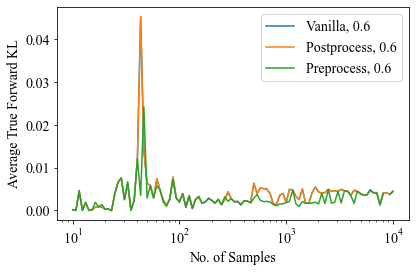

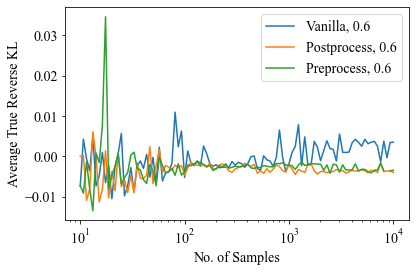

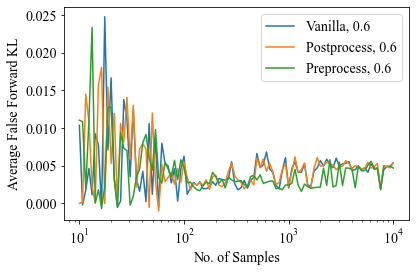

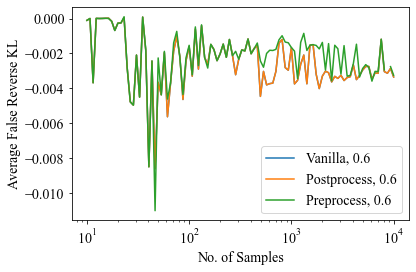

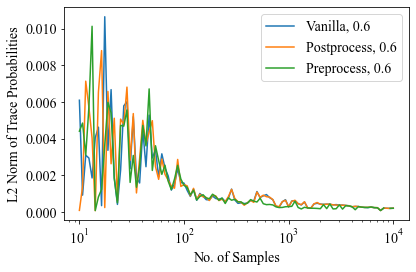

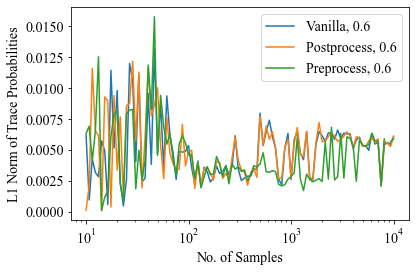

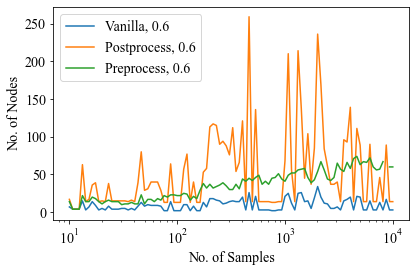

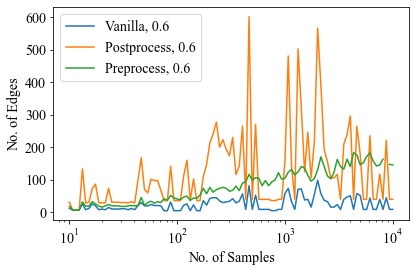

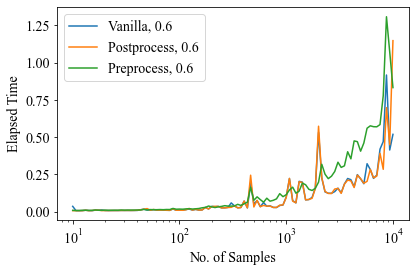

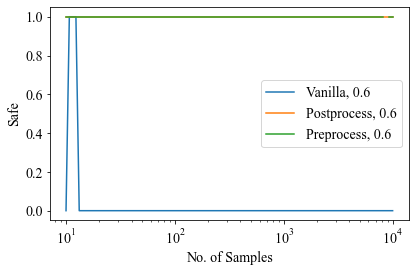

In [109]:
# Plot
evaluation.plot(x='num_samples', 
                selected_params={'p': '0.6', 'N': 20}, 
#                 figsize=(10, 8), 
                logx=True,
#                 logy=True,
                style={'Preprocess': '-x', 'Postprocess': '-*'})

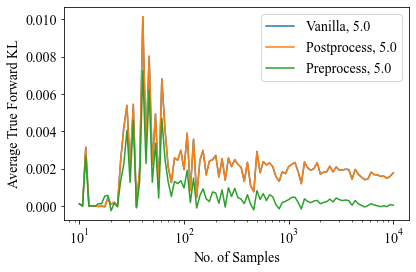

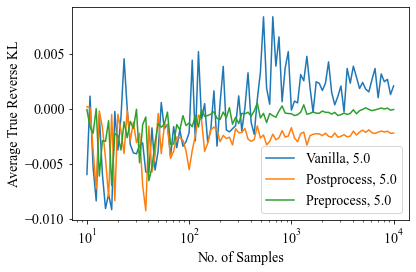

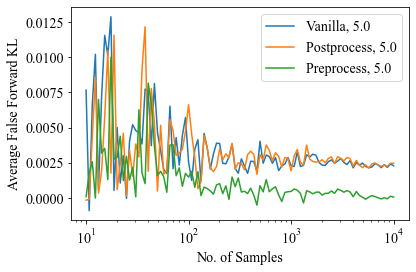

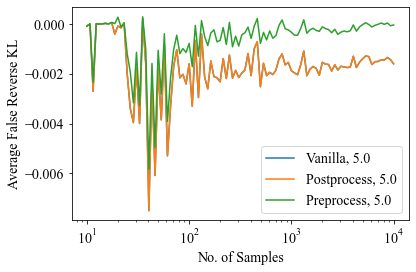

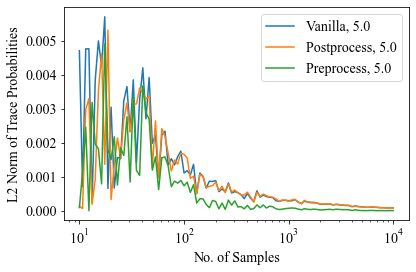

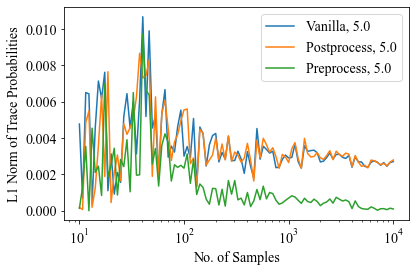

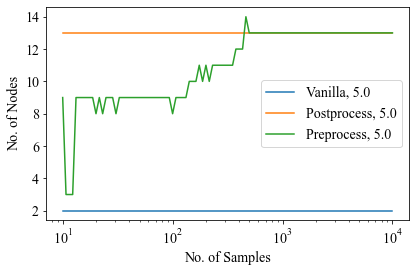

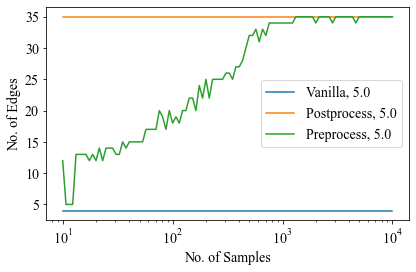

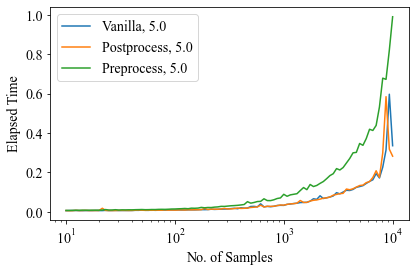

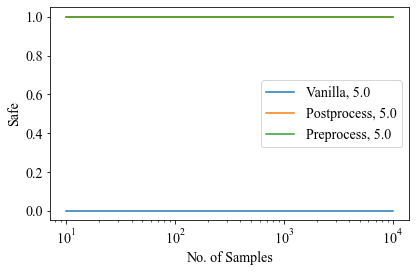

In [110]:
# Plot
evaluation.plot(x='num_samples', 
                selected_params={'p': '5.0', 'N': 20}, 
#                 figsize=(10, 8), 
                logx=True,
#                 logy=True,
                    style={'Preprocess': '-x', 'Postprocess': '-*'})

10000.0


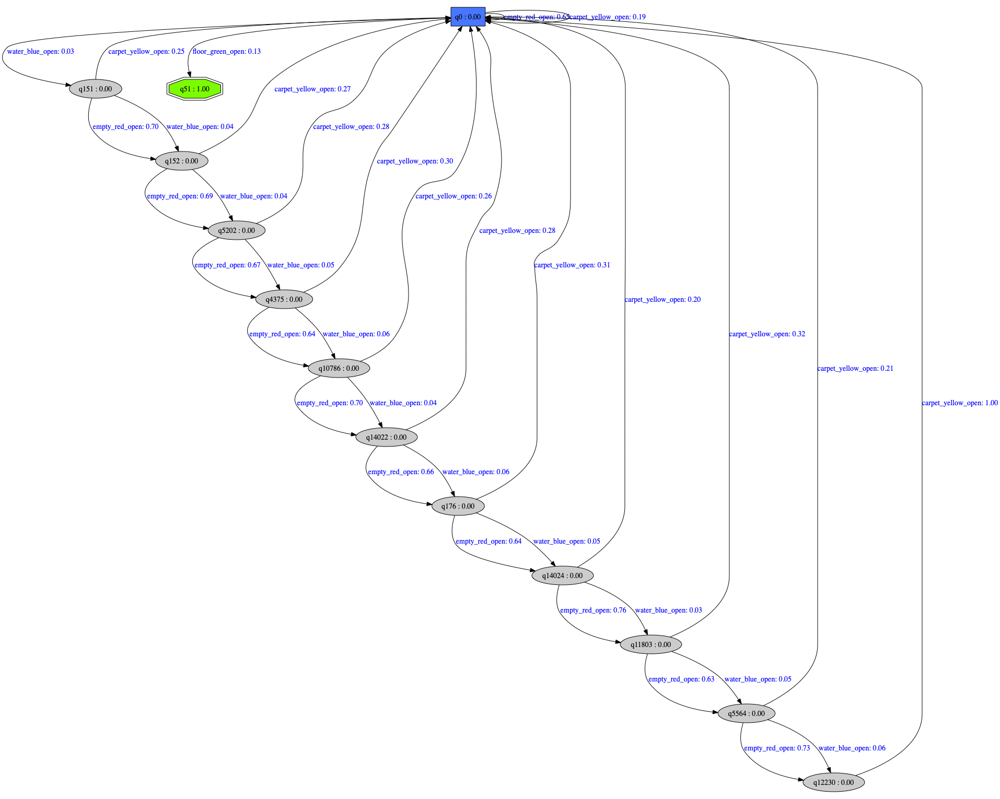

In [111]:
selected_params = {'p': '5.0',
                   'N': 20,
                   'clf': 'Preprocess',
#                    'clf': 'Vanilla',
                   'num_samples': num_samples[-2]}
filename = '_'.join([EXPERIMENT_NAME, env_id, 'learnedPDFA'])
print(num_samples[-1])
evaluation.draw(
    selected_params, 
    filename=filename)

In [112]:
selected_params = {'p': '5.0',
                   'N': 20,
                   'clf': 'Preprocess',
#                    'clf': 'VanillaSL',
                   'num_samples': num_samples[-2]}

learned_pdfa = evaluation.pdfa(selected_params)


# Experiment 3: Control Synthesis

We now synthesize a controller with the learned PDFA $\mathcal{A}_{est}$ , given an transition system $\mathcal{T}$ 

$$ \mathcal{P} = \mathcal{A}_{est} \times \mathcal{T} $$

Any path from "accepting" states to the initial state (we don't have accepting states but rather "accepting probability") completes the task. However, we propose a smarter way: Most Probable String.

We want to find the Most Probable String (strategy) that reflects demonstrator's preferences. 

$$ \omega* = \arg \max Pr(\mathcal{P}(\omega) \quad s.t. \mathbb{F}_{(\mathcal{P}, \mathbb{P})} ( \delta_{(\mathcal{P}, \mathbb{W})} (\lambda, \omega )) > 0$$

In [ ]:
solve_environment(learned_pdfa, ENV_ID_1, show_figures=True)

using env: MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0
using actions: simple_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)


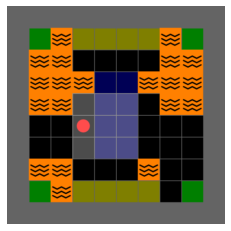

underlying transition system


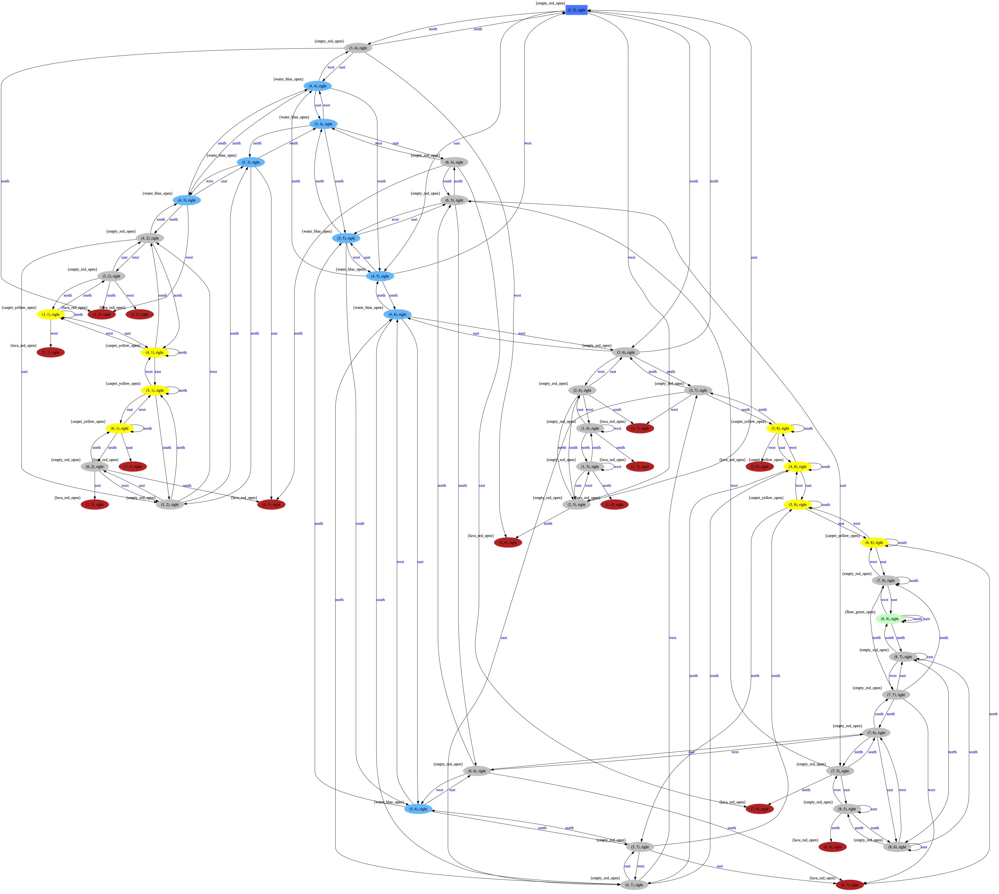

specification


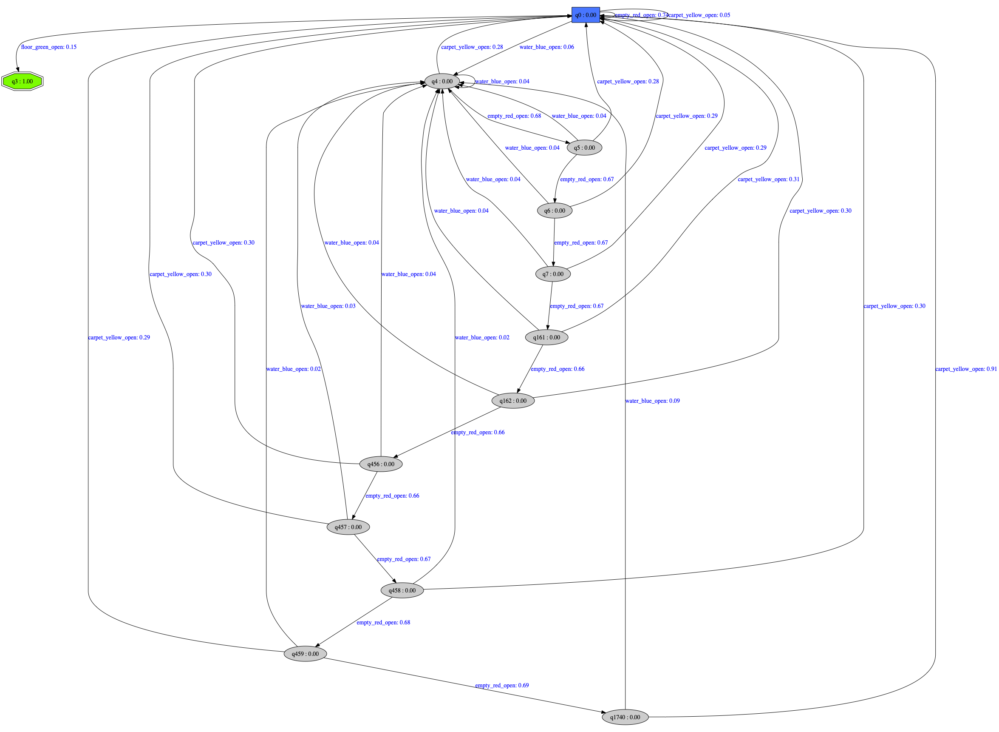

product automaton



Optimal Controls: ['south', 'south', 'east', 'east', 'north', 'east', 'east', 'south', 'south', 'west', 'east', 'east']
Probability of Generated TS Observations in Spec: 9.739118559686416e-05
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 6), right', '(3, 7), right', '(4, 7), right', '(5, 7), right', '(5, 6), right', '(6, 6), right', '(7, 6), right', '(7, 7), right', '(7, 8), right', '(6, 8), right', '(7, 8), right', '(8, 8), right']


In [72]:
solve_environment(learned_pdfa, ENV_ID_2, show_figures=True)

In [73]:
solve_environment(learned_pdfa, ENV_ID_1, actions_type='static')
solve_environment(learned_pdfa, ENV_ID_2, actions_type='static')
solve_environment(learned_pdfa, ENV_ID_1, actions_type='diag_static')
solve_environment(learned_pdfa, ENV_ID_2, actions_type='diag_static')

using env: MiniGrid-LavaComparison_seshia-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['left', 'forward', 'forward', 'forward', 'left', 'forward', 'forward', 'right', 'forward']
Probability of Generated TS Observations in Spec: 0.010304089444637898
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 5), up', '(3, 4), up', '(3, 3), up', '(3, 2), up', '(3, 2), left', '(2, 2), left', '(1, 2), left', '(1, 2), up', '(1, 1), up']


using env: MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['right', 'forward', 'forward', 'left', 'forward', 'forward', 'right', 'forward', 'left', 'forward', 'forward', 'forward']
Probability of Generated TS Observations in Spec: 1.0069438624095304e-06
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'carpet_yellow_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(3, 5), down', '(3, 6), down', '(3, 7), down', '(3, 7), right', '(4, 7), right', '(5, 7), right', '(5, 7), down', '(5, 8), down', '(5, 8), right', '(6, 8), right', '(7, 8), right', '(8, 8), right']


using env: MiniGrid-LavaComparison_seshia-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['northeast', 'northwest', 'northeast', 'northwest', 'southwest', 'northwest']
Probability of Generated TS Observations in Spec: 0.0006742020167085193
['empty_red_open', 'water_blue_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(4, 4), right', '(3, 3), right', '(4, 2), right', '(3, 1), right', '(2, 2), right', '(1, 1), right']


using env: MiniGrid-LavaComparison_SeshiaOnlyWaterPath-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['southwest', 'southeast', 'southeast', 'northeast', 'northeast', 'southeast', 'southeast']
Probability of Generated TS Observations in Spec: 0.0011504096800260307
['empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floor_green_open']
['(3, 5), right', '(2, 6), right', '(3, 7), right', '(4, 8), right', '(5, 7), right', '(6, 6), right', '(7, 7), right', '(8, 8), right']


In [74]:
all_actions_types = ['simple_static', 'static', 'diag_static']

all_experiments = itertools.product([ENV_ID_3, ENV_ID_4], all_actions_types)

for env_ID, actions_type in all_experiments:
    solve_environment(learned_pdfa, env_ID, actions_type=actions_type)

using env: MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Wide-v0
using actions: simple_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['east', 'east', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'north', 'east', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'south', 'south', 'south', 'south', 'south', 'south', 'south', 'east', 'south', 'south']
Probability of Generated TS Observations in Spec: 6.438001232000469e-06
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'floo

using env: MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Wide-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['forward', 'forward', 'left', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'left', 'forward']
Probability of Generated TS Observations in Spec: 1.9772868821476067e-06
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_o

using env: MiniGrid-AlternateLavaComparison_AllCorridorsOpen_Wide-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['northeast', 'northeast', 'northeast', 'northwest', 'northeast', 'northwest', 'northeast', 'northwest', 'northeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'southeast', 'southwest', 'southeast', 'southwest', 'southeast', 'southwest', 'southeast', 'southwest', 'southeast']
Probability of Generated TS Observations in Spec: 1.2969840882618178e-06
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'carpet_yellow_open', 'empty_red_open', 'empty_r

using env: MiniGrid-AlternateLavaComparison_OnlyWaterPath_Wide-v0
using actions: simple_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['east', 'north', 'north', 'east', 'north', 'north', 'east', 'north', 'north', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'south', 'south', 'south', 'west', 'west', 'west', 'west', 'west', 'west', 'south', 'south', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'east', 'north', 'north', 'north', 'east', 'south', 'south', 'south', 'south']
Probability of Generated TS Observations in Spec: 6.289375872762972e-40
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open',

using env: MiniGrid-AlternateLavaComparison_OnlyWaterPath_Wide-v0
using actions: static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['forward', 'forward', 'forward', 'left', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'right', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'left', 'forward', 'forward', 'left', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'forward', 'left', 'forward', 'forward', 'forward', 'forward', 'left', 'forward', 'left', 'forward', 'forward', 'forward', 'forward', 'forward', 'left', 'forward']
Probability of Generated TS Observations in Spec: 1.0563354923990237e-46
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 

using env: MiniGrid-AlternateLavaComparison_OnlyWaterPath_Wide-v0
using actions: diag_static


/Users/kandai/Documents/projects/research/wombats_experiments/wombats/systems/minigrid.py:717: RuntimeWarning: could not find any goal objects.
  warnings.warn(msg, RuntimeWarning)



Optimal Controls: ['northeast', 'northeast', 'northeast', 'northwest', 'northeast', 'northeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'southeast', 'southwest', 'southwest', 'northwest', 'southwest', 'northwest', 'southwest', 'southwest', 'southeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'southeast', 'northeast', 'northeast', 'northwest', 'northeast', 'southwest', 'southeast', 'southwest', 'southeast']
Probability of Generated TS Observations in Spec: 3.5655823721882386e-35
['empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'empty_red_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 'water_blue_open', 

# Plots


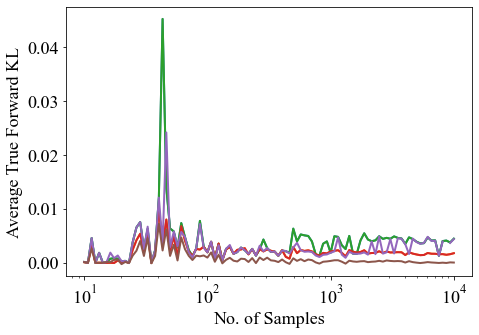

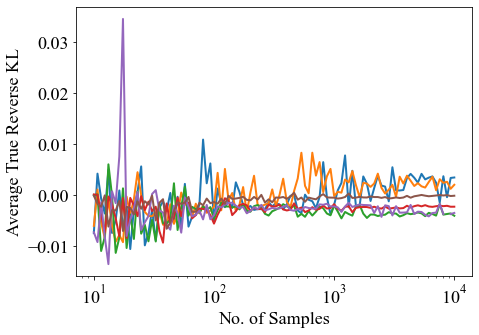

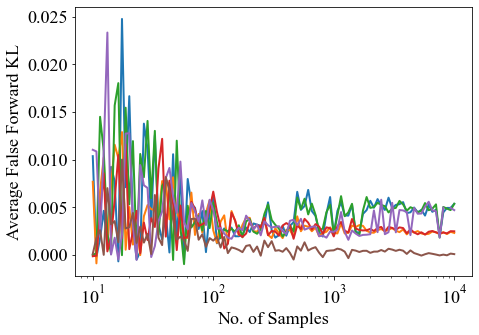

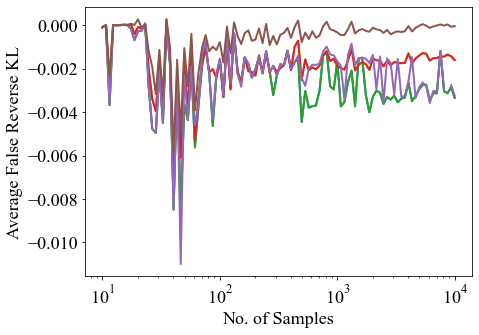

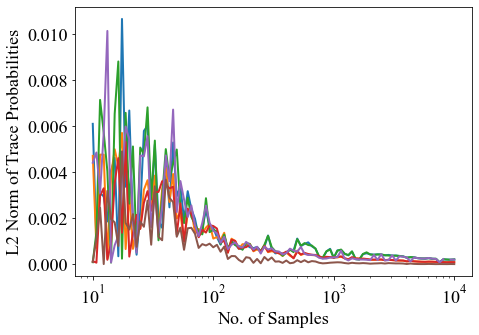

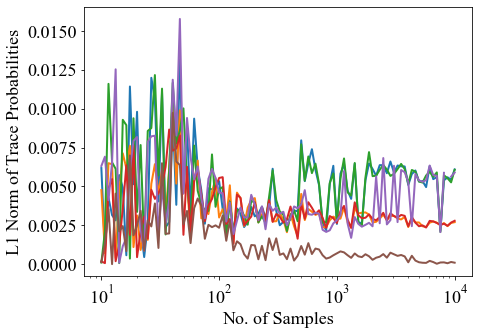

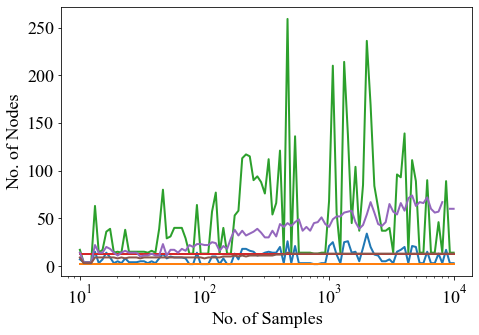

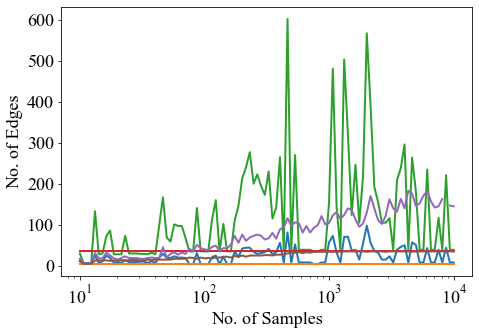

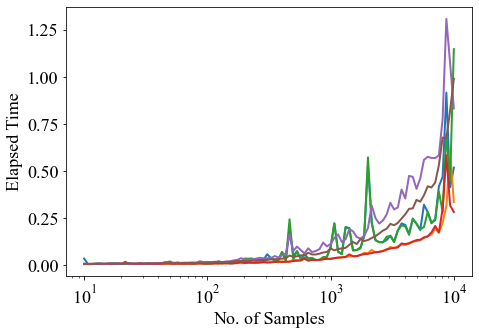

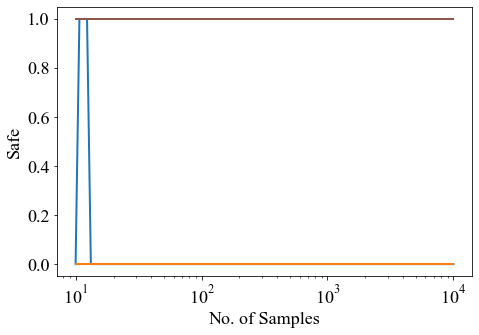

In [118]:
# Plot
evaluation.plot(x='num_samples', 
#                 selected_params={'p': ['0.6','5.0'], 'N': 20}, 
                selected_params={'N': 20}, 
                figsize=(7, 5), 
                logx=True,
#                 logy=True,
                lw=2,
                legend=False,
                style={'Preprocess': '-x', 'Postprocess': '-*'})
